In [3]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import lasio
import missingno as msno
import seaborn as sns
import numpy as np
# sys
import glob
import itertools
import os
import warnings
# data treatment
warnings.filterwarnings('ignore')
#%matplotlib notebook
%matplotlib inline
plt.rc('font', family='serif')


# 0- Case Scenarios Data Boxplots

In [32]:
Case_studies=pd.read_csv(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\CCUS_Case_Studies_Parameters.csv")
Case_studies.describe()

,Caprock(s) average thickness (ft),Formation depth (ft),Avg. reservoir thickness (ft),Formation pressure (psi),Formation temperature (F),Water salinity (ppm),Avg. Porosity (%),Avg. Permeability (mD)
count,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000
mean,714.857143,5392.142857,195.071429,2191.714286,133.571429,75942.857143,18.428571,217.428571
std,1056.391251,1481.024018,245.076932,691.809635,23.064093,68134.349075,9.289010,241.563558
min,36.000000,3000.000000,19.500000,1180.000000,108.000000,3600.000000,4.000000,10.000000
25%,89.000000,4700.000000,42.500000,1800.000000,116.000000,12500.000000,12.500000,21.000000
50%,290.000000,5500.000000,54.000000,2300.000000,130.000000,85000.000000,20.000000,70.000000
75%,750.000000,6150.000000,253.500000,2570.000000,149.000000,129500.000000,25.500000,425.000000
max,3000.000000,7545.000000,700.000000,3122.000000,167.000000,159000.000000,29.000000,550.000000


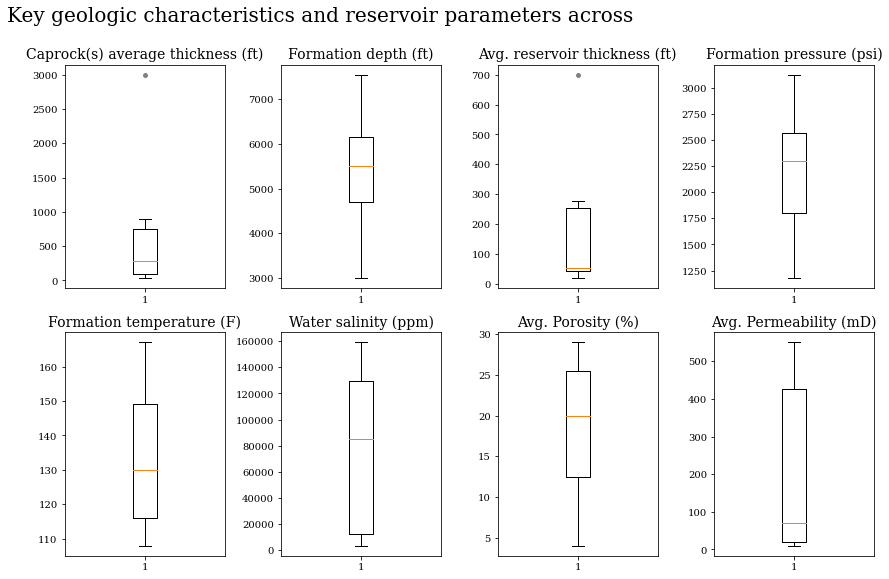

In [9]:
df=Case_studies.copy()
df.drop(["Project", "Overlying caprock(s)"], axis=1, inplace=True)

red_circle = dict(markerfacecolor='grey', marker='o', markeredgecolor='white')

fig, axs = plt.subplots(2, int(len(df.columns)/2), figsize=(12,8))
fig.suptitle('Key geologic characteristics and reservoir parameters across ', fontsize=20, x=0.35, y= 1)
for i, ax in enumerate(axs.flat):

    ax.boxplot(df.iloc[:,i], flierprops=red_circle)
    ax.set_title(df.columns[i], fontsize=14)
    ax.tick_params(axis='y', labelsize=10)
    
plt.tight_layout()

# 1- Exploratory Data Analysis

## a- Dataset2022\2_Data\Well Checkshots

In [33]:
pd.read_excel(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Checkshots\Penobscot Checkshots.xlsx", sheet_name =None)

{'Pen L-30':            Unnamed: 0 Unnamed: 1 Unnamed: 2  Unnamed: 3
 0                 NaN        NaN        NaN         NaN
 1                 NaN        NaN        NaN         NaN
 2                 NaN        NaN        NaN         NaN
 3                 NaN        NaN        NaN         NaN
 4                 NaN        NaN        NaN         NaN
 5                 NaN        NaN        NaN         NaN
 6                 NaN        NaN        NaN         NaN
 7   dgd=depth from SL        NaN        NaN         NaN
 8              Av dgd        dgd     Av tgd         NaN
 9                  ft          m          s         NaN
 10                362    110.338      0.073       146.0
 11                901    274.625      0.177       354.0
 12               1401    427.025      0.263       526.0
 13               1901    579.425      0.335       670.0
 14               2401    731.825      0.407       814.0
 15               2901    884.225     0.4705       941.0
 16               3

## b- Dataset2022\2_Data\Well Core PHI-K

In [34]:
pd.read_excel(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Core PHI-K\B41 CORE Porosity-Permeability.xlsx", header=2)

,BOREHOLE_NAME,UBHI,CORE_NAME,SAMPLE_ID,ANALYZING_COMPANY,TOP_DEPTH,BASE_DEPTH,DATE_OF_ANALYSIS,FORMATION,LITHOLOGY_DESCRIPTION,POROSITY,BULK_DENSITY,GRAIN_DENSITY,K90,KMAX,KVERT,PORE_VOLUME_OIL,PORE_VOLUME_WATER,BOREHOLE_ID
0,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3598,SHELL EXP & PROD LAB,2501.89,2501.89,1977-01-01,MIDDLE MISSISAUGA,DOLOMITE; LIMESTONE; SHALE; I/II; A,8.2,NaN,2.800,NaN,0.06,NaN,NaN,NaN,101354
1,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3599,SHELL EXP & PROD LAB,2502.13,2502.13,1977-01-01,MIDDLE MISSISAUGA,DOLOMITE; LIMESTONE; SHALE; I; A,5.1,NaN,2.738,NaN,1.29,NaN,NaN,NaN,101354
2,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3600,SHELL EXP & PROD LAB,2502.44,2502.44,1977-01-01,MIDDLE MISSISAUGA,LIMESTONE; ANHYDRITE; DOLOMITE; I; A,1.3,NaN,2.835,NaN,0.02,NaN,NaN,NaN,101354
3,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3601,SHELL EXP & PROD LAB,2502.74,2502.74,1977-01-01,MIDDLE MISSISAUGA,SAND; LIMESTONE; I; A,1.2,NaN,2.638,NaN,0.03,NaN,NaN,NaN,101354
4,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3602,SHELL EXP & PROD LAB,2503.05,2503.05,1977-01-01,MIDDLE MISSISAUGA,SAND; LIMESTONE; GLAUCONITIC; I; A,3.8,NaN,2.749,NaN,0.05,NaN,NaN,NaN,101354
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124,PENOBSCOT B-41,300B414420060000,CORE #04,Y-4026,SHELL EXP & PROD LAB,2700.74,2700.74,1977-01-01,MIDDLE MISSISAUGA,SAND; SILICEOUS; GLAUCONITIC; CONSOLIDATED; ME...,18.5,NaN,2.660,NaN,141.00,NaN,NaN,NaN,101354
125,PENOBSCOT B-41,300B414420060000,CORE #04,Y-4027,SHELL EXP & PROD LAB,2701.32,2701.32,1977-01-01,MIDDLE MISSISAUGA,SAND; SILICEOUS; GLAUCONITIC; CONSOLIDATED; ME...,26.9,NaN,2.658,NaN,69.00,NaN,NaN,NaN,101354
126,PENOBSCOT B-41,300B414420060000,CORE #04,NaN,SHELL EXP & PROD LAB,2701.60,2701.60,1977-01-01,MIDDLE MISSISAUGA,SAND; SILICEOUS; GLAUCONITIC; CONSOLIDATED; ME...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,101354
127,PENOBSCOT B-41,300B414420060000,CORE #04,Y-4028,SHELL EXP & PROD LAB,2701.69,2701.69,1977-01-01,MIDDLE MISSISAUGA,SAND; SILICEOUS; GLAUCONITIC; H; LARGE; FAIR,12.4,NaN,2.958,NaN,79.20,NaN,NaN,NaN,101354


In [35]:
pd.read_excel(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Core PHI-K\PENOBSCOT-B41.xls.xlsx", header=2)

,BOREHOLE_NAME,UBHI,CORE_NAME,SAMPLE_ID,ANALYZING_COMPANY,TOP_DEPTH,BASE_DEPTH,DATE_OF_ANALYSIS,FORMATION,LITHOLOGY_DESCRIPTION,POROSITY,BULK_DENSITY,GRAIN_DENSITY,K90,KMAX,KVERT,PORE_VOLUME_OIL,PORE_VOLUME_WATER,BOREHOLE_ID
0,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3598,SHELL EXP & PROD LAB,2501.89,2501.89,1977-01-01,MIDDLE MISSISAUGA,DOLOMITE; LIMESTONE; SHALE; I/II; A,8.2,NaN,2.800,NaN,0.06,NaN,NaN,NaN,101354
1,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3599,SHELL EXP & PROD LAB,2502.13,2502.13,1977-01-01,MIDDLE MISSISAUGA,DOLOMITE; LIMESTONE; SHALE; I; A,5.1,NaN,2.738,NaN,1.29,NaN,NaN,NaN,101354
2,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3600,SHELL EXP & PROD LAB,2502.44,2502.44,1977-01-01,MIDDLE MISSISAUGA,LIMESTONE; ANHYDRITE; DOLOMITE; I; A,1.3,NaN,2.835,NaN,0.02,NaN,NaN,NaN,101354
3,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3601,SHELL EXP & PROD LAB,2502.74,2502.74,1977-01-01,MIDDLE MISSISAUGA,SAND; LIMESTONE; I; A,1.2,NaN,2.638,NaN,0.03,NaN,NaN,NaN,101354
4,PENOBSCOT B-41,300B414420060000,CORE #01,Y-3602,SHELL EXP & PROD LAB,2503.05,2503.05,1977-01-01,MIDDLE MISSISAUGA,SAND; LIMESTONE; GLAUCONITIC; I; A,3.8,NaN,2.749,NaN,0.05,NaN,NaN,NaN,101354
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124,PENOBSCOT B-41,300B414420060000,CORE #04,Y-4026,SHELL EXP & PROD LAB,2700.74,2700.74,1977-01-01,MIDDLE MISSISAUGA,SAND; SILICEOUS; GLAUCONITIC; CONSOLIDATED; ME...,18.5,NaN,2.660,NaN,141.00,NaN,NaN,NaN,101354
125,PENOBSCOT B-41,300B414420060000,CORE #04,Y-4027,SHELL EXP & PROD LAB,2701.32,2701.32,1977-01-01,MIDDLE MISSISAUGA,SAND; SILICEOUS; GLAUCONITIC; CONSOLIDATED; ME...,26.9,NaN,2.658,NaN,69.00,NaN,NaN,NaN,101354
126,PENOBSCOT B-41,300B414420060000,CORE #04,NaN,SHELL EXP & PROD LAB,2701.60,2701.60,1977-01-01,MIDDLE MISSISAUGA,SAND; SILICEOUS; GLAUCONITIC; CONSOLIDATED; ME...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,101354
127,PENOBSCOT B-41,300B414420060000,CORE #04,Y-4028,SHELL EXP & PROD LAB,2701.69,2701.69,1977-01-01,MIDDLE MISSISAUGA,SAND; SILICEOUS; GLAUCONITIC; H; LARGE; FAIR,12.4,NaN,2.958,NaN,79.20,NaN,NaN,NaN,101354


In [36]:
core_data=pd.read_csv(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Core PHI-K\PENOBSCOT_B41.csv")
core_data.dropna()
core_data=core_data.loc[core_data['KMAX']>0]
core_data.describe()

,DEPTH,POROSITY,KMAX
count,121.000000,121.000000,121.000000
mean,2576.593884,11.923140,48.560744
std,78.891801,7.496263,163.669242
min,2501.890000,1.200000,0.010000
25%,2509.300000,6.000000,0.080000
50%,2514.840000,9.400000,0.200000
75%,2663.500000,17.700000,9.510000
max,2701.690000,31.800000,1060.000000


In [37]:
import statsmodels.api as sm

x = core_data['POROSITY']
y = np.log10(core_data['KMAX'])

model = sm.OLS(y, x, missing='drop')
results = model.fit()

results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                   KMAX   R-squared (uncentered):                   0.173
Model:                            OLS   Adj. R-squared (uncentered):              0.166
Method:                 Least Squares   F-statistic:                              25.12
Date:                Fri, 28 Oct 2022   Prob (F-statistic):                    1.88e-06
Time:                        17:52:47   Log-Likelihood:                         -194.80
No. Observations:                 121   AIC:                                      391.6
Df Residuals:                     120   BIC:                                      394.4
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
POROSITY       0.0394      0.008      5.012      0.000       0.024       0.055
==============================================================================
Omnibus:                       19.585   Durbin-Watson:                   0.545
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               16.332
Skew:                           0.803   Prob(JB):                     0.000284
Kurtosis:                       2.187   Cond. No.                         1.00
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [38]:
x = np.polyfit(core_data['POROSITY'], np.log10(core_data['KMAX']), 1)

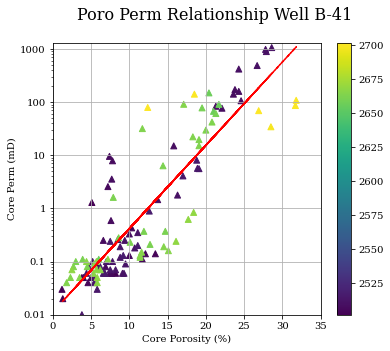

In [39]:
from matplotlib.ticker import FuncFormatter
fig, ax = plt.subplots(figsize=(6,5))

ax.axis([0, 35, 0.01, 1300])
cax1=ax.scatter(core_data['POROSITY'], core_data['KMAX'], c=core_data['DEPTH'] ,marker='^')
ax.set_yscale('log')
ax.grid(True)
ax.set_ylabel('Core Perm (mD)')
ax.set_xlabel('Core Porosity (%)')

cbar1 = fig.colorbar(cax1)

ax.semilogy(core_data['POROSITY'], 10**(x[0] * core_data['POROSITY'] + x[1]), 'r-', linestyle='dashed')

#Format the axes so that they show whole numbers
for axis in [ax.yaxis, ax.xaxis]:
    formatter = FuncFormatter(lambda y, _: '{:.16g}'.format(y))
    axis.set_major_formatter(formatter)
    
fig.suptitle('Poro Perm Relationship Well B-41', fontsize=16, )
plt.show()

## c- Dataset2022\2_Data\Well Logs LAS

In [40]:
# Read the Files
las_file_list = []
path = r'C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Logs LAS'
# View contents of the path, we will see LAS files plus an ASCII file
files = os.listdir(path)

for file in files:
    if file.lower().endswith('.las'):
        las_file_list.append(path + '\\' +file)
las_file_list
        
df_list = []
las_list = []

for lasfile in las_file_list:
    las = lasio.read(lasfile)
    las_list.append(las)
    lasdf = las.df()
    
    #lasdf['WELL'] = las.well.WELL.value
    #lasdf['DEPT'] = lasdf.index
    df_list.append(lasdf)
    
#.curves
for i in range(len(las_file_list)):
    print(f"The file {las_file_list[i][70:-20]} has a shape: {las_list[i].data.shape}")

The file Well Logs LAS\00-B41-44-20-06 has a shape: (15636, 13)
The file Well Logs LAS\00-L30-44-10-06 has a shape: (19607, 17)


In [42]:
#for i in range(len(files)):
#    las_list[i].to_csv(f"C:\\Users\\DELL\\Desktop\\CO2 Minus Challenge\\Dataset2022\\2_Data\\Well Logs LAS\\{files[i]}.csv")
print(las_list[0].curves)
print(las_list[1].curves)


Mnemonic  Unit  Value         Description                                  
--------  ----  -----         -----------                                  
DEPT      M     0   1  0  0   1 DEPTH                                      
AC        US/M  60 520 32  1  2 SONIC INTERVAL TRANSIT TIME (COMPENSATED)  
CAX       MM    60 280  1  1  3 SONIC CALIPER                              
DC        K/M3  42 356  1  1  4 DENSITY CORRECTION                         
DEN       K/M3  42 350  1  1  5 BULK DENSITY                               
GRS       GAPI  60 310  1  1  6 GAMMA RAY                                  
GRZ       GAPI  42 310  1  1  7 GAMMA RAY                                  
ILD       OHMM  7 120 46  1   8 DEEP INDUCTION                             
ILM       OHMM  7 120 44  1   9 MEDIUM INDUCTION                           
LL8       OHMM  7 220  8  1   10 LATEROLOG8                                
PDS       %     42 890 12  1  11 DENSITY POROSITY (SANDSTONE)              
POL       % 

In [43]:
# common columns
df_list[0].columns&df_list[1].columns

Index(['AC', 'CAX', 'DC', 'DEN', 'GRS', 'GRZ', 'ILD', 'ILM', 'LL8', 'PDS',
       'POL', 'SP'],
      dtype='object')

## d- Dataset2022\2_Data\Well Pressures

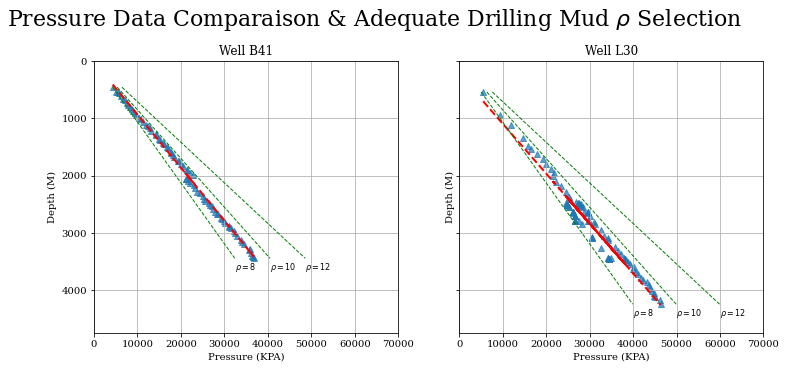

In [48]:
B41_Pressure=pd.read_excel(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Pressures\L-30 and B-41 Pressure Data from GSC - Corrected.xlsx", sheet_name=1)
L30_Pressure=pd.read_excel(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Pressures\L-30 and B-41 Pressure Data from GSC - Corrected.xlsx", sheet_name=0)

# Let's draw mud weight requieres 8, 10, 12, 14 ppg
L30_HP_0 = 8 * 0.052 * L30_Pressure['Depth (M)']*3.28 * 6.89475729
L30_HP_1 = 10 * 0.052 * L30_Pressure['Depth (M)']*3.28 * 6.89475729
L30_HP_2 = 12 * 0.052 * L30_Pressure['Depth (M)']*3.28 * 6.89475729
L30_HP_3 = 14 * 0.052 * L30_Pressure['Depth (M)']*3.28 * 6.89475729

B41_HP_0 = 8 * 0.052 * B41_Pressure['Depth (M)']*3.28 * 6.89475729
B41_HP_1 = 10 * 0.052 * B41_Pressure['Depth (M)']*3.28 * 6.89475729
B41_HP_2 = 12 * 0.052 * B41_Pressure['Depth (M)']*3.28 * 6.89475729
B41_HP_3 = 14 * 0.052 * B41_Pressure['Depth (M)']*3.28 * 6.89475729


fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, sharey=True, figsize=(12, 5))

# B41
x1= B41_Pressure['Pressure (KPA)']
y1= B41_Pressure['Depth (M)']
a1,b1 = np.polyfit(x1, y1, 1)
ax1.scatter(x=x1, y=y1, alpha=0.7, marker='^')
ax1.plot(x1, a1*x1+b1, color='red', linestyle='dashed', linewidth=2)
ax1.plot(B41_HP_0, y1, color='green', linestyle='dashed', linewidth=1)
ax1.plot(B41_HP_1, y1, color='green', linestyle='dashed', linewidth=1)
ax1.plot(B41_HP_2, y1, color='green', linestyle='dashed', linewidth=1)
#ax1.plot(B41_HP_3, y1, color='green', linestyle='dashed', linewidth=1)
ax1.set(xlabel='Pressure (KPA)', ylabel='Depth (M)',
       xlim=(0, 70000), ylim=(0, y1.max()+500),
       title='Well B41')
ax1.invert_yaxis()
ax1.grid(True)


ax1.text(B41_HP_0.max(), y1.max()+200, r'$\rho=8$', fontsize=8)
ax1.text(B41_HP_1.max(), y1.max()+200, r'$\rho=10$', fontsize=8)
ax1.text(B41_HP_2.max(), y1.max()+200, r'$\rho=12$', fontsize=8)
#ax1.text(B41_HP_3.max(), y1.max()+200, r'$\rho=14$', fontsize=8)



# L30
x2= L30_Pressure['Pressure (KPA)']
y2= L30_Pressure['Depth (M)']
a2,b2 = np.polyfit(x2, y2, 1)
ax2.scatter(x=x2, y=y2, alpha=0.7, marker='^')
ax2.plot(x2, a2*x2+b2, color='red', linestyle='dashed', linewidth=2)
ax2.plot(L30_HP_0, y2, color='green', linestyle='dashed', linewidth=1)
ax2.plot(L30_HP_1, y2, color='green', linestyle='dashed', linewidth=1)
ax2.plot(L30_HP_2, y2, color='green', linestyle='dashed', linewidth=1)
#ax2.plot(L30_HP_3, y2, color='green', linestyle='dashed', linewidth=1)

#ax2.text(2, 6, r'an equation: $E=mc^2$', fontsize=15)

ax2.set(xlabel='Pressure (KPA)', ylabel='Depth (M)',
       xlim=(0, 70000), ylim=(0, y2.max()+500),
       title='Well L30')
ax2.invert_yaxis()
ax2.grid(True)

ax2.text(L30_HP_0.max(), y2.max()+200, r'$\rho=8$', fontsize=8)
ax2.text(L30_HP_1.max(), y2.max()+200, r'$\rho=10$', fontsize=8)
ax2.text(L30_HP_2.max(), y2.max()+200, r'$\rho=12$', fontsize=8)
#ax2.text(L30_HP_3.max(), y2.max()+200, r'$\rho=14$', fontsize=8)


fig.suptitle(r'Pressure Data Comparaison & Adequate Drilling Mud $\rho$ Selection', fontsize=22, y=1.03, x=0.45)

plt.show()

In [49]:
import statsmodels.api as sm

x = B41_Pressure['Depth (M)']
y = B41_Pressure['Pressure (KPA)']

model = sm.OLS(y, x, missing='drop')
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:         Pressure (KPA)   R-squared (uncentered):                   1.000
Model:                            OLS   Adj. R-squared (uncentered):              0.999
Method:                 Least Squares   F-statistic:                          1.545e+05
Date:                Fri, 28 Oct 2022   Prob (F-statistic):                   6.35e-129
Time:                        17:53:32   Log-Likelihood:                         -597.05
No. Observations:                  78   AIC:                                      1196.
Df Residuals:                      77   BIC:                                      1198.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Depth (M)     10.7555      0.027    393.092      0.000      10.701      10.810
==============================================================================
Omnibus:                        3.929   Durbin-Watson:                   0.438
Prob(Omnibus):                  0.140   Jarque-Bera (JB):                3.572
Skew:                           0.524   Prob(JB):                        0.168
Kurtosis:                       3.012   Cond. No.                         1.00
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [50]:
B41_logs=pd.read_csv(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Logs LAS\00-B41-44-20-060-00-0 WELL LOGS.csv")
L30_logs=pd.read_csv(r"C:\Users\DELL\Desktop\Projects\CO2 Minus Challenge\Dataset2022\2_Data\Well Logs LAS\00-L30-44-10-060-00-0 WELL LOGS.csv")

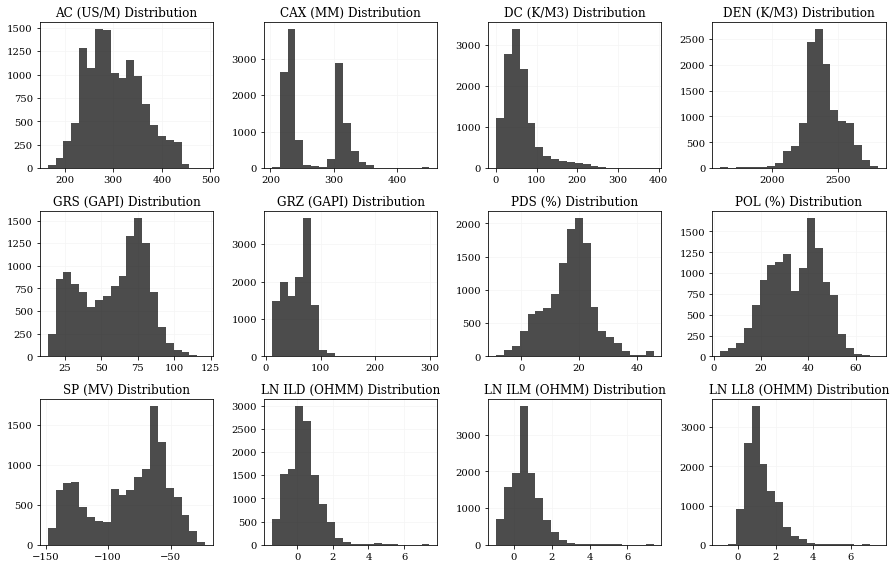

In [51]:
#df_y_test1=real_predict_data.copy()
#df_y_test1=df_y_test1[:4000]
data_sample=B41_logs

data_sample=data_sample.loc[(data_sample['DC (K/M3)']>0)]

data_sample['LN ILD (OHMM)']= np.log(data_sample['ILD (OHMM)'])
data_sample['LN ILM (OHMM)']= np.log(data_sample['ILM (OHMM)'])
data_sample['LN LL8 (OHMM)']= np.log(data_sample['LL8 (OHMM)'])

data_sample.drop(['ILD (OHMM)','ILM (OHMM)', 'LL8 (OHMM)'], axis=1, inplace= True)

cols_to_plot = list(data_sample)
cols_to_plot.remove('DEPT (M)')

#Setup the number of rows and columns for our plot
rows = 3
cols = 4

fig=plt.figure(figsize=(12.5,8))

for i, feature in enumerate(cols_to_plot):
    ax=fig.add_subplot(rows,cols,i+1)
    data_sample[feature].hist(bins=20,ax=ax,facecolor='black', alpha=0.7)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    ax.grid(color='whitesmoke')

plt.tight_layout()  
plt.show()

## e- Dataset2022\2_Data\Well Reports and Log PDFs

In [ ]:
# None explored for the moment

## f- Dataset2022\2_Data\Well Tops RFTS OWCs

In [52]:
formations_dict_B41={'Wyandot':[859,968],
                    'Dawson Canyon':[968, 1092],
                    'Petrel Member':[1093, 1114],
                     'Logan Canyon':[1115, 1202],
                    'Naskapi Member':[1202, 2142],
                    'Missisauga':[2143, 2247],
                    'Mic Mac':[2247, 3174],
                    'Abenaki Baccaro Member':[3174, 3210]}

formations_dict_L30={'Wyandot':[867,951],
                    'Dawson Canyon':[952, 1079],
                    'Petrel Member':[1080, 1183],
                    'Logan Canyon':[1184, 2139],
                    'Naskapi Member':[2140, 2251],
                    'Missisauga':[2252, 3191],
                    'Mic Mac':[3192, 3404],
                    'Abenaki Baccaro Member':[3405, 3697],
                    'Misaine Member':[3698, 3965],
                    'Scatarie Member':[3966, 4112],
                    'Mohican':[4113, 4200]}

# 2- Petrophysical Calculations

In [54]:
# Combining well logs and pressure data for B-41
B41_logs_pressure=pd.merge(B41_logs, B41_Pressure[['Depth (M)', 'Pressure (KPA)']], 
                           left_on='DEPT (M)', right_on='Depth (M)',
                           how='outer')

L30_logs_Pressure=pd.merge(L30_logs, L30_Pressure[['Depth (M)', 'Pressure (KPA)']], 
                           left_on='DEPT (M)', right_on='Depth (M)',
                           how='outer')

B41_logs_pressure.drop('Depth (M)', axis=1, inplace=True)
L30_logs_Pressure.drop('Depth (M)', axis=1, inplace=True)

In [55]:
def shale_volume(gamma_ray, gamma_ray_max, gamma_ray_min):
    vshale = (gamma_ray - gamma_ray_min) / (gamma_ray_max - gamma_ray_min)
    return round(vshale, 4)

def density_porosity(input_density, matrix_density, fluid_density):
    denpor = (matrix_density - input_density) / (matrix_density - fluid_density)
    return round(denpor, 4)

# Water saturation
def sw_archie(porosity, rt, rw, archieA, archieM, archieN):
    sw = ((archieA / (porosity ** archieM)) * (rw/rt))**(1/archieN)
    return sw

# equations from https://www.spec2000.net/01-quickmath.htm
def sw_simandoux(phie, rt, rw, archieA, archieM, archieN, vshale, rshale):
    A = (1 - vshale) * archieA * rw / (phie ** archieM)
    B = A * vshale / (2 * rshale)
    C = A / rt
    
    sw = ((B **2 + C)**0.5 - B) **(2 / archieN)
    return sw

In [56]:
#Calculate Shale Volume
B41_logs_pressure['VSHALE'] = shale_volume(B41_logs_pressure['GRS (GAPI)'], B41_logs_pressure['GRS (GAPI)'].quantile(q=0.99),
                             B41_logs_pressure['GRS (GAPI)'].quantile(q=0.01))

#Calculate Shale Volume
L30_logs_Pressure['VSHALE'] = shale_volume(L30_logs_Pressure['GRS (GAPI)'], L30_logs_Pressure['GRS (GAPI)'].quantile(q=0.99),
                             L30_logs_Pressure['GRS (GAPI)'].quantile(q=0.01))

<AxesSubplot:>

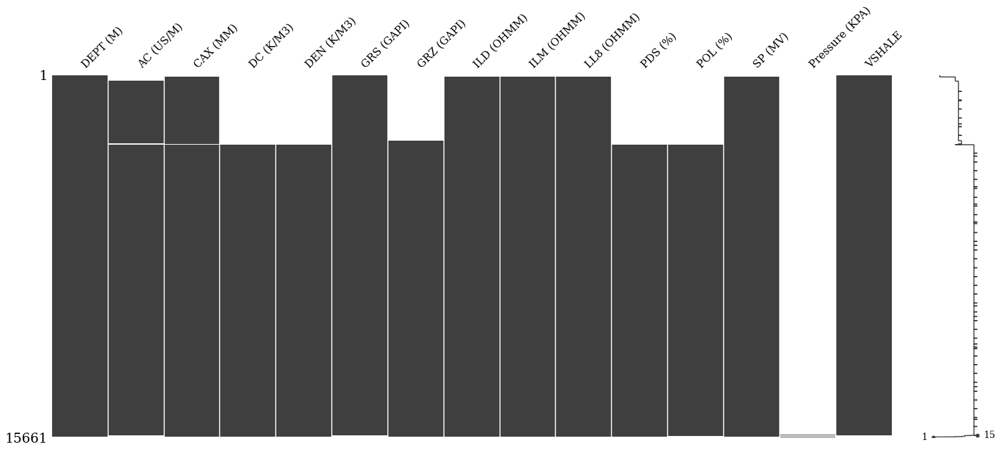

In [57]:
import missingno as msno
msno.matrix(B41_logs_pressure)

<AxesSubplot:>

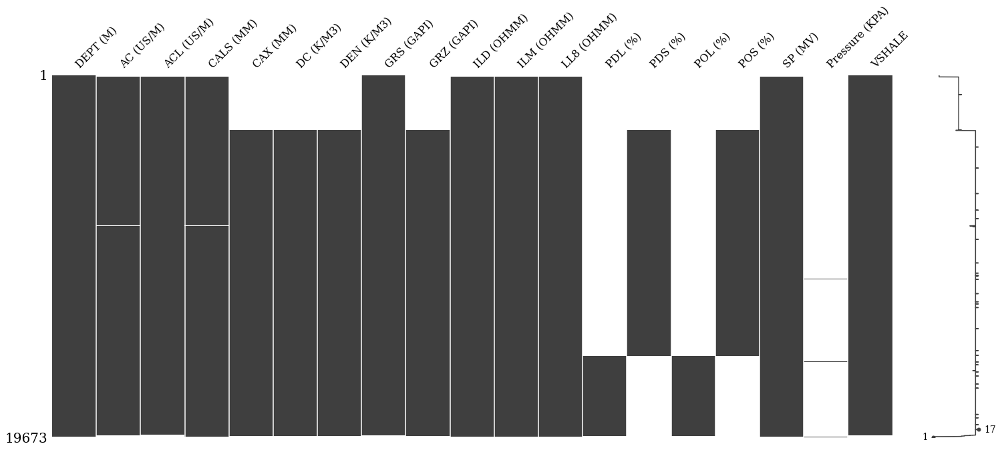

In [58]:
msno.matrix(L30_logs_Pressure)

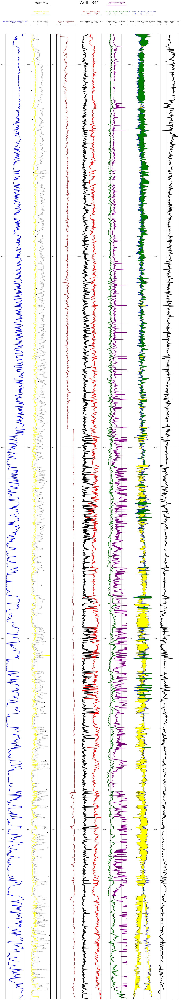

In [59]:
#df_y_test1=real_predict_data.copy()
#df_y_test1=df_y_test1[:4000]
data_sample=B41_logs_pressure

data_sample=data_sample.loc[(data_sample['DC (K/M3)']>0)]

data_sample['LN ILD (OHMM)']= np.log(data_sample['ILD (OHMM)'])
data_sample['LN ILM (OHMM)']= np.log(data_sample['ILM (OHMM)'])
data_sample['LN LL8 (OHMM)']= np.log(data_sample['LL8 (OHMM)'])


fig, ax = plt.subplots(figsize=(18,100), sharey=True)

#Set up the plot axes
ax1 = plt.subplot2grid((1,7), (0,0), rowspan=1, colspan = 1)
ax2 = plt.subplot2grid((1,7), (0,1), rowspan=1, colspan = 1)
ax3 = plt.subplot2grid((1,7), (0,2), rowspan=1, colspan = 1)
ax4 = plt.subplot2grid((1,7), (0,3), rowspan=1, colspan = 1)
ax5 = plt.subplot2grid((1,7), (0,4), rowspan=1, colspan = 1)
ax6 = plt.subplot2grid((1,7), (0,5), rowspan=1, colspan = 1)
ax7 = plt.subplot2grid((1,7), (0,6), rowspan=1, colspan = 1)


#ax4 = ax2.twiny() #Twins the y-axis for the density track with the neutron track
ax8 = ax2.twiny() # 'GRZ (GAPI)'
ax13= ax2.twiny()
ax9 = ax4.twiny()
ax10 = ax5.twiny()
ax11 = ax5.twiny()
ax12 = ax6.twiny()


# As our curve scales will be detached from the top of the track,
# this code adds the top border back in without dealing with splines
ax15 = ax1.twiny()
ax15.xaxis.set_visible(False)
ax20 = ax2.twiny()
ax20.xaxis.set_visible(False)
ax30 = ax3.twiny()
ax30.xaxis.set_visible(False)
ax40 = ax4.twiny()
ax40.xaxis.set_visible(False)
ax50 = ax5.twiny()
ax50.xaxis.set_visible(False)
ax60 = ax6.twiny()
ax60.xaxis.set_visible(False)
ax70 = ax7.twiny()
ax70.xaxis.set_visible(False)

# SP
ax1.plot(data_sample['SP (MV)'], data_sample['DEPT (M)'], color = "blue",linewidth=2)
ax1.set_xlabel("SPONTANEOUS POTENTIAL (MV)")
ax1.xaxis.label.set_color("blue")
ax1.set_xlim(data_sample['SP (MV)'].min(), data_sample['SP (MV)'].max())
ax1.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax1.tick_params(axis='x', colors="blue")
ax1.tick_params(axis='y', colors="black")
ax1.spines["top"].set_edgecolor("blue")
ax1.title.set_color('blue')


# 'GRS (GAPI)'
ax2.plot(data_sample['GRS (GAPI)'], data_sample['DEPT (M)'], color = "grey", linestyle='dashed', linewidth=1)
ax2.set_xlabel("GAMMA RAY (GAPI)")
ax2.xaxis.label.set_color("grey")
ax2.set_xlim(data_sample['GRS (GAPI)'].min(), data_sample['GRS (GAPI)'].max())
ax2.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax2.tick_params(axis='x', colors="grey")
ax2.tick_params(axis='y', colors="black")
ax2.spines["top"].set_edgecolor("grey")
ax2.title.set_color('grey')

             

# 'CAX (MM)'
ax3.plot(data_sample['CAX (MM)'], data_sample['DEPT (M)'], color = "brown",linewidth=2)
ax3.set_xlabel("SONIC CALIPER (MM)")
ax3.set_xlim(data_sample['CAX (MM)'].min(), data_sample['CAX (MM)'].max())
ax3.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax3.xaxis.label.set_color("brown")
ax3.tick_params(axis='x', colors="brown")
ax3.tick_params(axis='y', colors="black")
ax3.spines["top"].set_edgecolor("brown")
ax3.invert_xaxis()
                       


# 'DC (K/M3)'
ax4.plot(data_sample['DC (K/M3)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
ax4.set_xlabel("DENSITY CORRECTION (K/M3)")
ax4.set_xlim(data_sample['DC (K/M3)'].min(), data_sample['DC (K/M3)'].max())
ax4.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax4.xaxis.label.set_color("black")
ax4.tick_params(axis='x', colors="black")
ax4.tick_params(axis='y', colors="black")
ax4.spines["top"].set_edgecolor("black")
       
    
    
# 'ILD (OHMM)'
ax5.plot(data_sample['LN ILD (OHMM)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
ax5.set_xlabel("DEEP INDUCTION (OHMM)")
ax5.set_xlim(data_sample['LN ILD (OHMM)'].min(), data_sample['LN ILD (OHMM)'].max())
ax5.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax5.xaxis.label.set_color("black")
ax5.tick_params(axis='x', colors="black")
ax5.tick_params(axis='y', colors="black")
ax5.spines["top"].set_edgecolor("black")
    
    
# PDS
ax6.plot(data_sample['PDS (%)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
ax6.set_xlabel("DENSITY POROSITY (SANDSTONE)")
ax6.set_xlim(data_sample['PDS (%)'].min(), data_sample['PDS (%)'].max())
ax6.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax6.xaxis.label.set_color("black")
ax6.tick_params(axis='x', colors="black")
ax6.tick_params(axis='y', colors="black")
ax6.spines["top"].set_edgecolor("black")



# 'AC (US/M)'
ax7.plot(data_sample['AC (US/M)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
ax7.set_xlabel("TRANSIT TIME (COMPENSATED)")
ax7.set_xlim(data_sample['AC (US/M)'].min(), data_sample['AC (US/M)'].max())
ax7.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax7.xaxis.label.set_color("black")
ax7.tick_params(axis='x', colors="black")
ax7.tick_params(axis='y', colors="black")
ax7.spines["top"].set_edgecolor("black")



# 'GRZ (GAPI)'
ax8.plot(data_sample['GRZ (GAPI)'], data_sample['DEPT (M)'], color = "yellow",linewidth=2)
ax8.set_xlabel('GAMMA RAY 2 (GAPI)')
ax8.xaxis.label.set_color("yellow")
ax8.set_xlim(data_sample['GRZ (GAPI)'].min(), data_sample['GRZ (GAPI)'].max())
ax8.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax8.tick_params(axis='x', colors="yellow")
ax8.spines["top"].set_position(("axes", 1.02))
ax8.spines["top"].set_visible(True)
ax8.spines["top"].set_edgecolor("yellow")
#ax8.set_xticks([0.45,  0.15, -0.15])



# 'DEN (K/M3)'
ax9.plot(data_sample['DEN (K/M3)'], data_sample['DEPT (M)'], color = "red",linewidth=2)
ax9.set_xlabel('BULK DENSITY (K/M3)')
ax9.xaxis.label.set_color("red")
ax9.set_xlim(data_sample['DEN (K/M3)'].min(), data_sample['DEN (K/M3)'].max())
ax9.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax9.tick_params(axis='x', colors="red")
ax9.spines["top"].set_position(("axes", 1.02))
ax9.spines["top"].set_visible(True)
ax9.spines["top"].set_edgecolor("red")
#ax8.set_xticks([0.45,  0.15, -0.15])


# ILM
ax10.plot(data_sample['LN ILM (OHMM)'], data_sample['DEPT (M)'], color = "green",linewidth=2)
ax10.set_xlabel('MEDIUM INDUCTION (OHMM)')
ax10.xaxis.label.set_color("green")
ax10.set_xlim(data_sample['LN ILM (OHMM)'].min(), data_sample['LN ILM (OHMM)'].max())
ax10.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax10.tick_params(axis='x', colors="green")
ax10.spines["top"].set_position(("axes", 1.02))
ax10.spines["top"].set_visible(True)
ax10.spines["top"].set_edgecolor("green")
#ax8.set_xticks([0.45,  0.15, -0.15])



# 'LL8 (OHMM)'
ax11.plot(data_sample['LL8 (OHMM)'], data_sample['DEPT (M)'], color = "purple",linewidth=2)
ax11.set_xlabel('LATEROLOG8 (OHMM)')
ax11.xaxis.label.set_color("purple")
ax11.set_xlim(data_sample['LN LL8 (OHMM)'].min(), data_sample['LN LL8 (OHMM)'].max())
ax11.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax11.tick_params(axis='x', colors="purple")
ax11.spines["top"].set_position(("axes", 1.03))
ax11.spines["top"].set_visible(True)
ax11.spines["top"].set_edgecolor("purple")
#ax8.set_xticks([0.45,  0.15, -0.15])



# 'POL (%)'
ax12.plot(data_sample['POL (%)'], data_sample['DEPT (M)'], color = "blue",linewidth=1, linestyle='-')
ax12.set_xlabel('NEUTRON POROSITY (LIMESTONE)')
ax12.xaxis.label.set_color("blue")
ax12.set_xlim(data_sample['POL (%)'].max(), data_sample['POL (%)'].min())
ax12.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax12.tick_params(axis='x', colors="blue")
ax12.spines["top"].set_position(("axes", 1.02))
ax12.spines["top"].set_visible(True)
ax12.spines["top"].set_edgecolor("blue")
#ax12.invert_xaxis()
#ax8.set_xticks([0.45,  0.15, -0.15])


# 'Pressure (KPA)'
ax13.scatter(data_sample['Pressure (KPA)'], data_sample['DEPT (M)'], color = "black", marker='^')
ax13.set_xlabel('Pressure (KPA)')
ax13.xaxis.label.set_color("black")
ax13.set_xlim(data_sample['Pressure (KPA)'].min(), data_sample['Pressure (KPA)'].max())
ax13.set_ylim(np.max(data_sample['DEPT (M)']), np.min(data_sample['DEPT (M)']))
ax13.tick_params(axis='x', colors="black")
ax13.spines["top"].set_position(("axes", 1.03))
ax13.spines["top"].set_visible(True)
ax13.spines["top"].set_edgecolor("black")


# Filling the blank
x1=data_sample['POL (%)']
x2=data_sample['PDS (%)']

x = np.array(ax12.get_xlim()) #pol
z = np.array(ax6.get_xlim()) #pds

nz=((x2-np.max(z))/(np.min(z)-np.max(z)))*(np.max(x)-np.min(x))+np.min(x)

ax12.fill_betweenx(data_sample['DEPT (M)'], x1, nz, where=x1>=nz, interpolate=True, color='green')
ax12.fill_betweenx(data_sample['DEPT (M)'], x1, nz, where=x1<=nz, interpolate=True, color='yellow')


# Common functions for setting up the plot can be extracted into
# a for loop. This saves repeating code.
for ax in [ax1,ax2,ax3,ax4,ax5,ax6,ax7]:
    ax.grid(which='major', color='lightgrey', linestyle='-')
    ax.xaxis.set_ticks_position("top")
    ax.xaxis.set_label_position("top")
    ax.spines["top"].set_position(("axes", 1.01)) 
    
fig.suptitle('Well: B41',fontsize=30, y=1)
fig.tight_layout()

In [60]:
# Adding formation tops
formations_dict_B41

formation_midpoints_41 = []
for key, value in formations_dict_B41.items():
    formation_midpoints_41.append(value[0] + (value[1]-value[0])/2)
    
# Select the same number of colors as there are formations
zone_colors = ["red", "blue", "green", "yellow", 'pink', 'brown', 'purple']

In [61]:
#formation_midpoints_41[2]=formation_midpoints_41[2]+100
formation_midpoints_41

[913.5, 1030.0, 1103.5, 1158.5, 1672.0, 2195.0, 2710.5, 3192.0]

In [62]:
def makeplot(depth, gamma, res, neut, dens, dtc, formations_dict, topdepth, bottomdepth,
            colors):
    fig, ax = plt.subplots(figsize=(15,30))

    #Set up the plot axes
    ax1 = plt.subplot2grid((1,10), (0,0), rowspan=1, colspan = 3)
    ax2 = plt.subplot2grid((1,10), (0,3), rowspan=1, colspan = 3, sharey = ax1)
    ax3 = plt.subplot2grid((1,10), (0,6), rowspan=1, colspan = 3, sharey = ax1)
    ax4 = ax3.twiny() 
    ax5 = plt.subplot2grid((1,10), (0,9), rowspan=1, colspan = 1, sharey = ax1)

    # As our curve scales will be detached from the top of the track,
    # this code adds the top border back in without dealing with splines
    ax10 = ax1.twiny()
    ax10.xaxis.set_visible(False)
    ax11 = ax2.twiny()
    ax11.xaxis.set_visible(False)
    ax12 = ax3.twiny()
    ax12.xaxis.set_visible(False)

    # Gamma Ray track
    
    ## Setting up the track and curve
    ax1.plot(gamma, depth, color = "green", linewidth = 0.5)
    ax1.set_xlabel("Gamma")
    ax1.xaxis.label.set_color("green")
    ax1.set_xlim(0, gamma.max())
    ax1.set_ylabel("Depth (m)")
    ax1.tick_params(axis='x', colors="green")
    ax1.spines["top"].set_edgecolor("green")
    ax1.title.set_color('green')
    #ax1.set_xticks([0, 50, 100, 150])
    #ax1.text(0.05, 1.04, 0, color='green', 
    #         horizontalalignment='left', transform=ax1.transAxes)
    #ax1.text(0.95, 1.04, 150, color='green', 
    #         horizontalalignment='right', transform=ax1.transAxes)
    ax1.set_xticklabels([])
    
    ## Setting Up Shading for GR
    left_col_value = 0
    right_col_value = gamma.max()
    span = abs(left_col_value - right_col_value)
    cmap = plt.get_cmap('hot_r')
    color_index = np.arange(left_col_value, right_col_value, span / 100)
    #loop through each value in the color_index
    for index in sorted(color_index):
        index_value = (index - left_col_value)/span
        color = cmap(index_value) #obtain color for color index value
        ax1.fill_betweenx(depth, gamma , right_col_value, where = gamma >= index,  color = color)
    
    
    
    # Resistivity track
    ax2.plot(res, depth, color = "red", linewidth = 0.5)
    ax2.set_xlabel("Resistivity")
    ax2.set_xlim(0.2, 2000)
    ax2.xaxis.label.set_color("red")
    ax2.tick_params(axis='x', colors="red")
    ax2.spines["top"].set_edgecolor("red")
    ax2.set_xticks([0.1, 1, 10, 100, 1000])
    ax2.semilogx()
    ax2.text(0.05, 1.04, 0.1, color='red', 
             horizontalalignment='left', transform=ax2.transAxes)
    ax2.text(0.95, 1.04, 1000, color='red', 
             horizontalalignment='right', transform=ax2.transAxes)
    ax2.set_xticklabels([])

    # Density track
    ax3.plot(dens, depth, color = "red", linewidth = 0.5)
    ax3.set_xlabel("Density")
    ax3.set_xlim(dens.min(), dens.max())
    ax3.xaxis.label.set_color("red")
    ax3.tick_params(axis='x', colors="red")
    ax3.spines["top"].set_edgecolor("red")
    #ax3.set_xticks([1.95, 2.45, 2.95])
    #ax3.text(0.05, 1.04, 1.95, color='red', 
    #         horizontalalignment='left', transform=ax3.transAxes)
    #ax3.text(0.95, 1.04, 2.95, color='red', 
    #         horizontalalignment='right', transform=ax3.transAxes)
    ax3.set_xticklabels([])


    # Neutron track placed ontop of density track
    ax4.plot(neut, depth, color = "blue", linewidth = 0.5)
    ax4.set_xlabel('Neutron')
    ax4.xaxis.label.set_color("blue")
    ax4.set_xlim(neut.max(), neut.min())
    ax4.tick_params(axis='x', colors="blue")
    ax4.spines["top"].set_position(("axes", 1.08))
    ax4.spines["top"].set_visible(True)
    ax4.spines["top"].set_edgecolor("blue")
    #ax4.set_xticks([45,  15, -15])
    #ax4.text(0.05, 1.1, 45, color='blue', 
    #         horizontalalignment='left', transform=ax4.transAxes)
    #ax4.text(0.95, 1.1, -15, color='blue', 
    #          horizontalalignment='right', transform=ax4.transAxes)
    ax4.set_xticklabels([])

    ax5.set_xticklabels([])
    ax5.text(0.5, 1.1, 'Formations', fontweight='bold',
             horizontalalignment='center', transform=ax5.transAxes)
    
    # Adding in neutron density shading
    x1=dens
    x2=neut

    x = np.array(ax3.get_xlim())
    z = np.array(ax4.get_xlim())

    nz=((x2-np.max(z))/(np.min(z)-np.max(z)))*(np.max(x)-np.min(x))+np.min(x)

    ax3.fill_betweenx(depth, x1, nz, where=x1>=nz, interpolate=True, color='green')
    ax3.fill_betweenx(depth, x1, nz, where=x1<=nz, interpolate=True, color='yellow')
    
    
    # Common functions for setting up the plot can be extracted into
    # a for loop. This saves repeating code.
    for ax in [ax1, ax2, ax3]:
        ax.set_ylim(bottomdepth, topdepth)
        ax.grid(which='major', color='lightgrey', linestyle='-')
        ax.xaxis.set_ticks_position("top")
        ax.xaxis.set_label_position("top")
        ax.spines["top"].set_position(("axes", 1.02))
    
    for ax in [ax1, ax2, ax3, ax5]:
        # loop through the formations dictionary and zone colors
        for depth, color in zip(formations_dict.values(), colors):
            # use the depths and colors to shade across the subplots
            ax.axhspan(depth[0], depth[1], color=color, alpha=0.1)


    for ax in [ax2, ax3, ax4, ax5]:
        plt.setp(ax.get_yticklabels(), visible = False)
    
    for label, formation_mid in zip(formations_dict.keys(), 
                                    formation_midpoints_41):
        ax5.text(0.5, formation_mid, label, rotation=90,
                verticalalignment='center', fontweight='bold',
                fontsize='large')

    plt.tight_layout()
    fig.subplots_adjust(wspace = 0)

In [ ]:
makeplot(B41_logs_pressure['DEPT (M)'], B41_logs_pressure['GRZ (GAPI)'], B41_logs_pressure['ILD (OHMM)'], B41_logs_pressure['POL (%)'],
        B41_logs_pressure['PDS (%)'], B41_logs_pressure['SP (MV)'], formations_dict_B41, 800, 3500, zone_colors)

In [ ]:
df = pd.DataFrame(data=np.random.randint(1,10,10), columns=['a'])
df
criteria = [df['a'].between(1, 3), df['a'].between(4, 7), df['a'].between(8, 10)]
values = [1, 2, 3]

df['b'] = np.select(criteria, values, 0)
df

d = {range(1, 4): 'Wyandot', range(4, 8): 'Dawson Canyon', range(8, 11): 'Petrel Member',
    range(1, 4): 'Logan Canyon', range(4, 8): 'Naskapi Member', range(8, 11): 'Missisauga'}

df['c'] = df['a'].apply(lambda x: next((v for k, v in d.items() if x in k), 0))

In [64]:
df=B41_logs_pressure.copy()
#df = pd.DataFrame(data=np.random.randint(1,10,10), columns=['a'])
criteria = [df['DEPT (M)'].between(859, 968), 
            df['DEPT (M)'].between(968, 1092), 
            df['DEPT (M)'].between(1093, 1114),
            df['DEPT (M)'].between(1115, 1202),
           df['DEPT (M)'].between(1202, 2142),
           df['DEPT (M)'].between(2143, 2247),
           df['DEPT (M)'].between(2247, 3174),
           df['DEPT (M)'].between(3174, 3210),]
values = ['Wyandot', 'Dawson Canyon', 'Petrel Member', 'Logan Canyon',
          'Naskapi Member', 'Missisauga', 'Mic Mac', 'Abenaki Baccaro Member']

B41_logs_pressure['Formation'] = np.select(criteria, values, None)
B41_logs_pressure.Formation.value_counts()

Naskapi Member            4700
Mic Mac                   4635
Dawson Canyon              620
Wyandot                    546
Missisauga                 521
Logan Canyon               436
Abenaki Baccaro Member     180
Petrel Member              106
Name: Formation, dtype: int64

In [65]:
df=L30_logs_Pressure.copy()
#df = pd.DataFrame(data=np.random.randint(1,10,10), columns=['a'])
criteria = [df['DEPT (M)'].between(867, 951), 
            df['DEPT (M)'].between(952, 1079), 
            df['DEPT (M)'].between(1080, 1183),
            df['DEPT (M)'].between(1184, 2139),
           df['DEPT (M)'].between(2140, 2251),
           df['DEPT (M)'].between(2252, 3191),
           df['DEPT (M)'].between(3192, 3404),
           df['DEPT (M)'].between(3405, 3697),]
values = ['Wyandot', 'Dawson Canyon', 'Petrel Member', 'Logan Canyon',
          'Naskapi Member', 'Missisauga', 'Mic Mac', 'Abenaki Baccaro Member']

L30_logs_Pressure['Formation'] = np.select(criteria, values, None)
L30_logs_Pressure.Formation.value_counts()

Logan Canyon              4776
Missisauga                4708
Abenaki Baccaro Member    1463
Mic Mac                   1061
Dawson Canyon              636
Naskapi Member             556
Petrel Member              516
Wyandot                    421
Name: Formation, dtype: int64

# Well logs + Pressure Data + Well Tops + Lithology type
# B-41

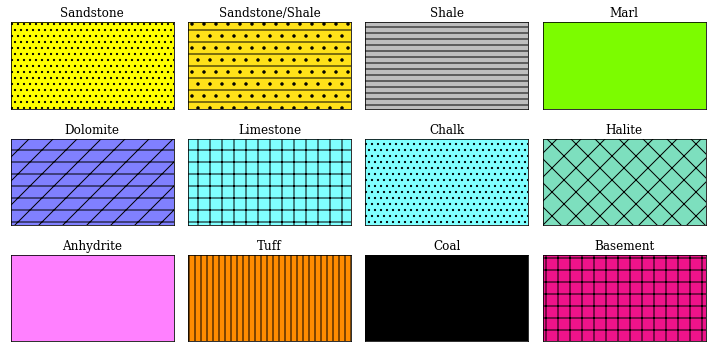

In [66]:
lithology_numbers = {30000: {'lith':'Sandstone', 'lith_num':1, 'hatch': '..', 'color':'#ffff00'},
                 65030: {'lith':'Sandstone/Shale', 'lith_num':2, 'hatch':'-.', 'color':'#ffe119'},
                 65000: {'lith':'Shale', 'lith_num':3, 'hatch':'--', 'color':'#bebebe'},
                 80000: {'lith':'Marl', 'lith_num':4, 'hatch':'', 'color':'#7cfc00'},
                 74000: {'lith':'Dolomite', 'lith_num':5, 'hatch':'-/', 'color':'#8080ff'},
                 70000: {'lith':'Limestone', 'lith_num':6, 'hatch':'+', 'color':'#80ffff'},
                 70032: {'lith':'Chalk', 'lith_num':7, 'hatch':'..', 'color':'#80ffff'},
                 88000: {'lith':'Halite', 'lith_num':8, 'hatch':'x', 'color':'#7ddfbe'},
                 86000: {'lith':'Anhydrite', 'lith_num':9, 'hatch':'', 'color':'#ff80ff'},
                 99000: {'lith':'Tuff', 'lith_num':10, 'hatch':'||', 'color':'#ff8c00'},
                 90000: {'lith':'Coal', 'lith_num':11, 'hatch':'', 'color':'black'},
                 93000: {'lith':'Basement', 'lith_num':12, 'hatch':'-|', 'color':'#ef138a'}}

df_lith = pd.DataFrame.from_dict(lithology_numbers, orient='index')
df_lith.index.name = 'LITHOLOGY'

y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=4,nrows=3, sharex=True, sharey=True,
                         figsize=(10,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, lithology_numbers.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=lithology_numbers[key]['color'], hatch=lithology_numbers[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(lithology_numbers[key]['lith']))

plt.tight_layout()

plt.show()



## B41_logs

In [67]:
#df_y_test1=real_predict_data.copy()
#df_y_test1=df_y_test1[:4000]
#data_sample=B41_logs_pressure

print('This is depth range of the: ', data_sample['DEPT (M)'].min(),data_sample['DEPT (M)'].max())
data_sample=B41_logs_pressure.copy()
data_sample['LITHOLOGY']=np.NaN

data_sample=data_sample.loc[(data_sample['DC (K/M3)']>0)]

data_sample['LN ILD (OHMM)']= np.log(data_sample['ILD (OHMM)'])
data_sample['LN ILM (OHMM)']= np.log(data_sample['ILM (OHMM)'])
data_sample['LN LL8 (OHMM)']= np.log(data_sample['LL8 (OHMM)'])

data_sample['LITHOLOGY']=np.NaN
for i in data_sample.index:
    if data_sample['GRS (GAPI)'][i]<=30:
        data_sample['LITHOLOGY'][i]=30000 
    elif data_sample['GRS (GAPI)'][i]>30 and data_sample['GRS (GAPI)'][i]<=60:
        data_sample['LITHOLOGY'][i]=65030
    elif data_sample['GRS (GAPI)'][i]>60 and data_sample['GRS (GAPI)'][i]<=90:
        data_sample['LITHOLOGY'][i]=65000        
    elif data_sample['GRS (GAPI)'][i]>90:
        data_sample['LITHOLOGY'][i]=80000

data_sample.LITHOLOGY.value_counts()
#data_sample.loc[(data_sample.LITHOLOGY)==1]

This is depth range of the:  919.8 3444.0


65000.0    6103
65030.0    3776
30000.0    2101
80000.0     521
Name: LITHOLOGY, dtype: int64

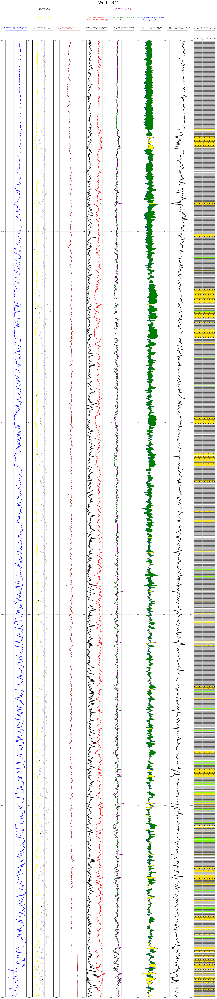

In [68]:
def log(well_name, data_sample, max_depth, min_depth):
    fig, ax = plt.subplots(figsize=(22,100), sharey=True)

    #Set up the plot axes
    ax1 = plt.subplot2grid((1,8), (0,0), rowspan=1, colspan = 1)
    ax2 = plt.subplot2grid((1,8), (0,1), rowspan=1, colspan = 1)
    ax3 = plt.subplot2grid((1,8), (0,2), rowspan=1, colspan = 1)
    ax4 = plt.subplot2grid((1,8), (0,3), rowspan=1, colspan = 1)
    ax5 = plt.subplot2grid((1,8), (0,4), rowspan=1, colspan = 1)
    ax6 = plt.subplot2grid((1,8), (0,5), rowspan=1, colspan = 1)
    ax7 = plt.subplot2grid((1,8), (0,6), rowspan=1, colspan = 1)
    ax14 = plt.subplot2grid((1,8), (0,7), rowspan=1, colspan = 1) #Litho


    #ax4 = ax2.twiny() #Twins the y-axis for the density track with the neutron track
    ax8  = ax2.twiny() # 'GRZ (GAPI)'
    ax13 = ax2.twiny()
    ax9  = ax4.twiny()
    ax10 = ax5.twiny()
    ax11 = ax5.twiny()
    ax12 = ax6.twiny()
    ax15 = ax14.twiny()


    # As our curve scales will be detached from the top of the track,
    # this code adds the top border back in without dealing with splines
    ax15 = ax1.twiny()
    ax15.xaxis.set_visible(False)
    ax20 = ax2.twiny()
    ax20.xaxis.set_visible(False)
    ax30 = ax3.twiny()
    ax30.xaxis.set_visible(False)
    ax40 = ax4.twiny()
    ax40.xaxis.set_visible(False)
    ax50 = ax5.twiny()
    ax50.xaxis.set_visible(False)
    ax60 = ax6.twiny()
    ax60.xaxis.set_visible(False)
    ax70 = ax7.twiny()
    ax70.xaxis.set_visible(False)

    # SP
    ax1.plot(data_sample['SP (MV)'], data_sample['DEPT (M)'], color = "blue",linewidth=2)
    ax1.set_xlabel("SPONTANEOUS POTENTIAL (MV)")
    ax1.xaxis.label.set_color("blue")
    ax1.set_xlim(data_sample['SP (MV)'].min(), data_sample['SP (MV)'].max())
    ax1.set_ylim(max_depth, min_depth)
    ax1.tick_params(axis='x', colors="blue")
    ax1.tick_params(axis='y', colors="black")
    ax1.spines["top"].set_edgecolor("blue")
    ax1.title.set_color('blue')


    # 'GRS (GAPI)'
    ax2.plot(data_sample['GRS (GAPI)'], data_sample['DEPT (M)'], color = "grey", linestyle='dashed', linewidth=1)
    ax2.set_xlabel("GAMMA RAY (GAPI)")
    ax2.xaxis.label.set_color("grey")
    ax2.set_xlim(data_sample['GRS (GAPI)'].min(), data_sample['GRS (GAPI)'].max())
    ax2.set_ylim(max_depth, min_depth)
    ax2.tick_params(axis='x', colors="grey")
    ax2.tick_params(axis='y', colors="black")
    ax2.spines["top"].set_edgecolor("grey")
    ax2.title.set_color('grey')



    # 'CAX (MM)'
    ax3.plot(data_sample['CAX (MM)'], data_sample['DEPT (M)'], color = "brown",linewidth=2)
    ax3.set_xlabel("SONIC CALIPER (MM)")
    ax3.set_xlim(data_sample['CAX (MM)'].min(), data_sample['CAX (MM)'].max())
    ax3.set_ylim(max_depth, min_depth)
    ax3.xaxis.label.set_color("brown")
    ax3.tick_params(axis='x', colors="brown")
    ax3.tick_params(axis='y', colors="black")
    ax3.spines["top"].set_edgecolor("brown")
    ax3.invert_xaxis()



    # 'DC (K/M3)'
    ax4.plot(data_sample['DC (K/M3)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
    ax4.set_xlabel("DENSITY CORRECTION (K/M3)")
    ax4.set_xlim(data_sample['DC (K/M3)'].min(), data_sample['DC (K/M3)'].max())
    ax4.set_ylim(max_depth, min_depth)
    ax4.xaxis.label.set_color("black")
    ax4.tick_params(axis='x', colors="black")
    ax4.tick_params(axis='y', colors="black")
    ax4.spines["top"].set_edgecolor("black")



    # 'ILD (OHMM)'
    ax5.plot(data_sample['LN ILD (OHMM)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
    ax5.set_xlabel("DEEP INDUCTION (OHMM)")
    ax5.set_xlim(data_sample['LN ILD (OHMM)'].min(), data_sample['LN ILD (OHMM)'].max())
    ax5.set_ylim(max_depth, min_depth)
    ax5.xaxis.label.set_color("black")
    ax5.tick_params(axis='x', colors="black")
    ax5.tick_params(axis='y', colors="black")
    ax5.spines["top"].set_edgecolor("black")


    # PDS
    ax6.plot(data_sample['PDS (%)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
    ax6.set_xlabel("DENSITY POROSITY (SANDSTONE)")
    ax6.set_xlim(data_sample['PDS (%)'].min(), data_sample['PDS (%)'].max())
    ax6.set_ylim(max_depth, min_depth)
    ax6.xaxis.label.set_color("black")
    ax6.tick_params(axis='x', colors="black")
    ax6.tick_params(axis='y', colors="black")
    ax6.spines["top"].set_edgecolor("black")



    # 'AC (US/M)'
    ax7.plot(data_sample['AC (US/M)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
    ax7.set_xlabel("TRANSIT TIME (COMPENSATED)")
    ax7.set_xlim(data_sample['AC (US/M)'].min(), data_sample['AC (US/M)'].max())
    ax7.set_ylim(max_depth, min_depth)
    ax7.xaxis.label.set_color("black")
    ax7.tick_params(axis='x', colors="black")
    ax7.tick_params(axis='y', colors="black")
    ax7.spines["top"].set_edgecolor("black")



    # 'GRZ (GAPI)'
    ax8.plot(data_sample['GRZ (GAPI)'], data_sample['DEPT (M)'], color = "yellow",linewidth=2)
    ax8.set_xlabel('GAMMA RAY 2 (GAPI)')
    ax8.xaxis.label.set_color("yellow")
    ax8.set_xlim(data_sample['GRZ (GAPI)'].min(), data_sample['GRZ (GAPI)'].max())
    ax8.set_ylim(max_depth, min_depth)
    ax8.tick_params(axis='x', colors="yellow")
    ax8.spines["top"].set_position(("axes", 1.02))
    ax8.spines["top"].set_visible(True)
    ax8.spines["top"].set_edgecolor("yellow")
    #ax8.set_xticks([0.45,  0.15, -0.15])



    # 'DEN (K/M3)'
    ax9.plot(data_sample['DEN (K/M3)'], data_sample['DEPT (M)'], color = "red",linewidth=2)
    ax9.set_xlabel('BULK DENSITY (K/M3)')
    ax9.xaxis.label.set_color("red")
    ax9.set_xlim(data_sample['DEN (K/M3)'].min(), data_sample['DEN (K/M3)'].max())
    ax9.set_ylim(max_depth, min_depth)
    ax9.tick_params(axis='x', colors="red")
    ax9.spines["top"].set_position(("axes", 1.02))
    ax9.spines["top"].set_visible(True)
    ax9.spines["top"].set_edgecolor("red")
    #ax8.set_xticks([0.45,  0.15, -0.15])


    # ILM
    ax10.plot(data_sample['LN ILM (OHMM)'], data_sample['DEPT (M)'], color = "green",linewidth=2)
    ax10.set_xlabel('MEDIUM INDUCTION (OHMM)')
    ax10.xaxis.label.set_color("green")
    ax10.set_xlim(data_sample['LN ILM (OHMM)'].min(), data_sample['LN ILM (OHMM)'].max())
    ax10.set_ylim(max_depth, min_depth)
    ax10.tick_params(axis='x', colors="green")
    ax10.spines["top"].set_position(("axes", 1.02))
    ax10.spines["top"].set_visible(True)
    ax10.spines["top"].set_edgecolor("green")
    #ax8.set_xticks([0.45,  0.15, -0.15])



    # 'LL8 (OHMM)'
    ax11.plot(data_sample['LN LL8 (OHMM)'], data_sample['DEPT (M)'], color = "purple",linewidth=2)
    ax11.set_xlabel('LATEROLOG8 (OHMM)')
    ax11.xaxis.label.set_color("purple")
    ax11.set_xlim(data_sample['LN LL8 (OHMM)'].min(), data_sample['LN LL8 (OHMM)'].max())
    ax11.set_ylim(max_depth, min_depth)
    ax11.tick_params(axis='x', colors="purple")
    ax11.spines["top"].set_position(("axes", 1.03))
    ax11.spines["top"].set_visible(True)
    ax11.spines["top"].set_edgecolor("purple")
    #ax8.set_xticks([0.45,  0.15, -0.15])



    # 'POL (%)'
    ax12.plot(data_sample['POL (%)'], data_sample['DEPT (M)'], color = "blue",linewidth=1, linestyle='-')
    ax12.set_xlabel('NEUTRON POROSITY (LIMESTONE)')
    ax12.xaxis.label.set_color("blue")
    ax12.set_xlim(data_sample['POL (%)'].max(), data_sample['POL (%)'].min())
    ax12.set_ylim(max_depth, min_depth)
    ax12.tick_params(axis='x', colors="blue")
    ax12.spines["top"].set_position(("axes", 1.02))
    ax12.spines["top"].set_visible(True)
    ax12.spines["top"].set_edgecolor("blue")
    #ax12.invert_xaxis()
    #ax8.set_xticks([0.45,  0.15, -0.15])


    # 'Pressure (KPA)'
    ax13.scatter(data_sample['Pressure (KPA)'], data_sample['DEPT (M)'], color = "black", marker='^')
    ax13.set_xlabel('Pressure (KPA)')
    ax13.xaxis.label.set_color("black")
    ax13.set_xlim(data_sample['Pressure (KPA)'].min(), data_sample['Pressure (KPA)'].max())
    ax13.set_ylim(max_depth, min_depth)
    ax13.tick_params(axis='x', colors="black")
    ax13.spines["top"].set_position(("axes", 1.03))
    ax13.spines["top"].set_visible(True)
    ax13.spines["top"].set_edgecolor("black")



    # Lithology track
    ax14.plot(data_sample.LITHOLOGY,data_sample['DEPT (M)'], color = "black", linewidth = 0.5)
    ax14.set_xlabel("Lithology")
    ax14.set_xlim(0, 1)
    ax14.set_ylim(max_depth, min_depth)
    ax14.xaxis.label.set_color("black")
    ax14.tick_params(axis='x', colors="black")
    ax14.spines["top"].set_edgecolor("black")

    for key in lithology_numbers.keys():
        color = lithology_numbers[key]['color']
        hatch = lithology_numbers[key]['hatch']
        ax14.fill_betweenx(data_sample['DEPT (M)'], 0, data_sample.LITHOLOGY, where=(data_sample.LITHOLOGY==key),
                         facecolor=color, hatch=hatch)


    # Filling the blank
    x1=data_sample['POL (%)']
    x2=data_sample['PDS (%)']

    x = np.array(ax12.get_xlim()) #pol
    z = np.array(ax6.get_xlim()) #pds

    nz=((x2-np.max(z))/(np.min(z)-np.max(z)))*(np.max(x)-np.min(x))+np.min(x)

    ax12.fill_betweenx(data_sample['DEPT (M)'], x1, nz, where=x1>=nz, interpolate=True, color='green')
    ax12.fill_betweenx(data_sample['DEPT (M)'], x1, nz, where=x1<=nz, interpolate=True, color='yellow')


    # Common functions for setting up the plot can be extracted into
    # a for loop. This saves repeating code.
    for ax in [ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax14]:
        ax.grid(which='major', color='lightgrey', linestyle='-')
        ax.xaxis.set_ticks_position("top")
        ax.xaxis.set_label_position("top")
        ax.spines["top"].set_position(("axes", 1.01)) 

    fig.suptitle(well_name,fontsize=30, y=1.006)
    fig.tight_layout()
    
log('Well : B41',data_sample,2000, 1000)

## L30_logs

In [69]:
#df_y_test1=real_predict_data.copy()
#df_y_test1=df_y_test1[:4000]
data_sample=L30_logs_Pressure

data_sample=data_sample.loc[(data_sample['DC (K/M3)']>0)]

data_sample['LN ILD (OHMM)']= np.log(data_sample['ILD (OHMM)'])
data_sample['LN ILM (OHMM)']= np.log(data_sample['ILM (OHMM)'])
data_sample['LN LL8 (OHMM)']= np.log(data_sample['LL8 (OHMM)'])

data_sample.drop(['ILD (OHMM)','ILM (OHMM)', 'LL8 (OHMM)'], axis=1, inplace= True)


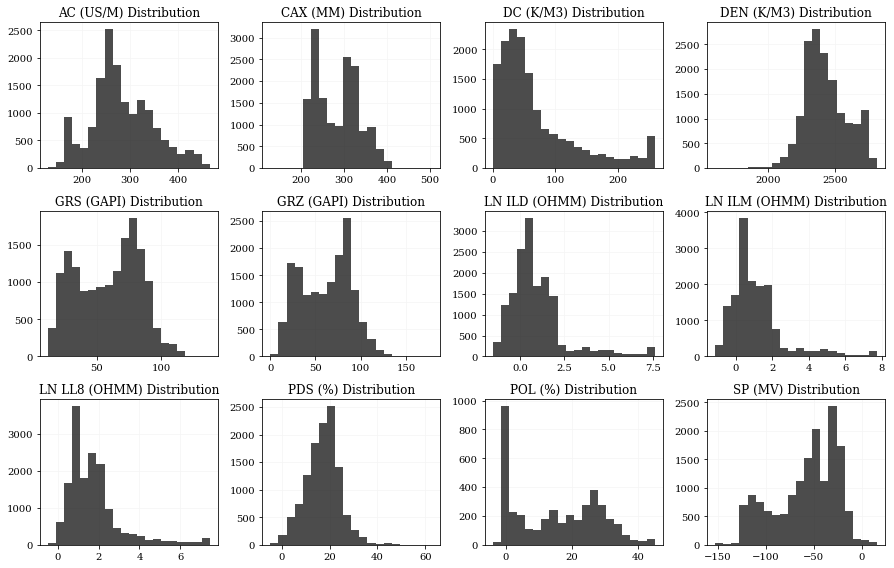

In [70]:
cols_to_plot = list(['DEPT (M)', 'AC (US/M)', 'CAX (MM)', 'DC (K/M3)', 'DEN (K/M3)',
       'GRS (GAPI)', 'GRZ (GAPI)', 'LN ILD (OHMM)', 'LN ILM (OHMM)', 'LN LL8 (OHMM)',
       'PDS (%)', 'POL (%)', 'SP (MV)'])
cols_to_plot.remove('DEPT (M)')
#cols_to_plot.remove('PDL (%)')

#Setup the number of rows and columns for our plot
rows = 3
cols = 4

fig=plt.figure(figsize=(12.5,8))

for i, feature in enumerate(cols_to_plot):
    ax=fig.add_subplot(rows,cols,i+1)
    data_sample[feature].hist(bins=20,ax=ax,facecolor='black', alpha=0.7)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    ax.grid(color='whitesmoke')

plt.tight_layout()  
plt.show()

In [71]:
data_sample['LITHOLOGY']=np.NaN
for i in data_sample.index:
    if data_sample['GRS (GAPI)'][i]<=30:
        data_sample['LITHOLOGY'][i]=30000 
    elif data_sample['GRS (GAPI)'][i]>30 and data_sample['GRS (GAPI)'][i]<=60:
        data_sample['LITHOLOGY'][i]=65030
    elif data_sample['GRS (GAPI)'][i]>60 and data_sample['GRS (GAPI)'][i]<=90:
        data_sample['LITHOLOGY'][i]=65000        
    elif data_sample['GRS (GAPI)'][i]>90:
        data_sample['LITHOLOGY'][i]=80000

data_sample.LITHOLOGY.value_counts()

65000.0    6879
65030.0    4669
30000.0    2756
80000.0    1383
Name: LITHOLOGY, dtype: int64

In [72]:
data_sample

,DEPT (M),AC (US/M),ACL (US/M),CALS (MM),CAX (MM),DC (K/M3),DEN (K/M3),GRS (GAPI),GRZ (GAPI),PDL (%),...,POL (%),POS (%),SP (MV),Pressure (KPA),VSHALE,Formation,LN ILD (OHMM),LN ILM (OHMM),LN LL8 (OHMM),LITHOLOGY
3009,932.4,454.7440,323.8181,304.6184,334.3698,19.7724,2005.6033,31.5187,34.1490,NaN,...,NaN,56.9733,-46.4925,NaN,0.1683,Wyandot,0.235941,0.295129,0.223064,65030.0
3010,932.6,397.0582,308.2006,306.0851,343.4746,8.7696,2038.0999,31.0836,35.6844,NaN,...,NaN,51.8357,-46.0632,NaN,0.1637,Wyandot,0.408793,0.495671,0.505491,65030.0
3011,932.8,366.1666,303.5962,307.0383,358.8392,25.5780,2084.3674,32.5875,37.2198,NaN,...,NaN,50.9597,-45.1756,NaN,0.1798,Wyandot,0.581377,0.709955,0.784130,65030.0
3012,933.0,360.5646,295.7245,306.8248,368.2364,33.6701,2103.0371,35.0695,38.8045,NaN,...,NaN,51.2144,-44.4311,NaN,0.2063,Wyandot,0.762627,0.908138,1.078205,65030.0
3013,933.2,359.6604,292.5966,306.6248,370.7031,38.1068,2093.4482,34.1961,40.5120,NaN,...,NaN,51.6258,-43.9234,NaN,0.1970,Wyandot,0.930903,1.000742,1.213963,65030.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19605,4248.8,NaN,NaN,202.7890,226.1178,109.6577,2640.3259,NaN,0.2660,4.6532,...,NaN,NaN,-27.2364,NaN,NaN,None,1.654392,1.755597,2.264696,NaN
19606,4249.0,NaN,NaN,202.7410,224.5178,99.5738,2655.7380,NaN,0.2463,3.6027,...,NaN,NaN,-26.9191,NaN,NaN,None,1.624780,1.666631,2.266512,NaN
19607,4249.2,NaN,NaN,203.1636,223.1382,79.5527,2655.8447,NaN,0.2267,3.4110,...,NaN,NaN,-27.0803,NaN,NaN,None,1.607937,1.598337,2.082724,NaN
19608,4249.4,NaN,NaN,203.2000,221.9382,93.0184,2652.6389,NaN,0.2070,3.9562,...,NaN,NaN,-27.6194,NaN,NaN,None,1.594649,1.577328,1.910372,NaN


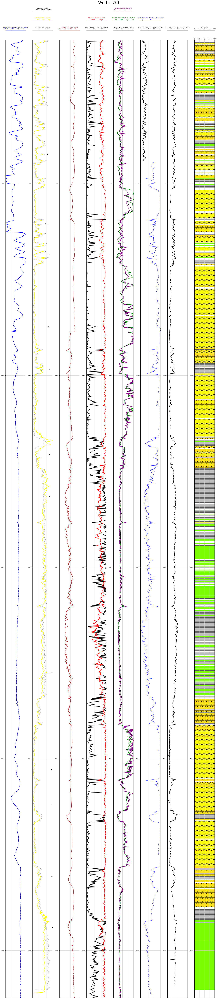

In [73]:
log('Well : L30', data_sample, max(data_sample['DEPT (M)']), 3250)

In [74]:
data_sample.to_csv('Complete L30 log with LITHO')

# What about clustering to find the most suitable formation for sequatration?

In [182]:
B41_logs.columns & L30_logs.columns

Index(['DEPT (M)', 'AC (US/M)', 'CAX (MM)', 'DC (K/M3)', 'DEN (K/M3)',
       'GRS (GAPI)', 'GRZ (GAPI)', 'ILD (OHMM)', 'ILM (OHMM)', 'LL8 (OHMM)',
       'PDS (%)', 'POL (%)', 'SP (MV)'],
      dtype='object')

In [103]:
df=B41_logs_pressure.copy()
#df = pd.DataFrame(data=np.random.randint(1,10,10), columns=['a'])
criteria = [df['DEPT (M)'].between(859, 968), 
            df['DEPT (M)'].between(968, 1092), 
            df['DEPT (M)'].between(1093, 1114),
            df['DEPT (M)'].between(1115, 1202),
           df['DEPT (M)'].between(1202, 2142),
           df['DEPT (M)'].between(2143, 2247),
           df['DEPT (M)'].between(2247, 3174),
           df['DEPT (M)'].between(3174, 3210),]
values = ['Wyandot', 'Dawson Canyon', 'Petrel Member', 'Logan Canyon',
          'Naskapi Member', 'Missisauga', 'Mic Mac', 'Abenaki Baccaro Member']

B41_logs_pressure['Formation'] = np.select(criteria, values, None)
B41_logs_pressure.Formation.value_counts()


df=L30_logs_Pressure.copy()
#df = pd.DataFrame(data=np.random.randint(1,10,10), columns=['a'])
criteria = [df['DEPT (M)'].between(859, 968), 
            df['DEPT (M)'].between(968, 1092), 
            df['DEPT (M)'].between(1093, 1114),
            df['DEPT (M)'].between(1115, 1202),
           df['DEPT (M)'].between(1202, 2142),
           df['DEPT (M)'].between(2143, 2247),
           df['DEPT (M)'].between(2247, 3174),
           df['DEPT (M)'].between(3174, 3210),]
values = ['Wyandot', 'Dawson Canyon', 'Petrel Member', 'Logan Canyon',
          'Naskapi Member', 'Missisauga', 'Mic Mac', 'Abenaki Baccaro Member']

L30_logs_Pressure['Formation'] = np.select(criteria, values, None)
L30_logs_Pressure.Formation.value_counts()

Naskapi Member            4700
Mic Mac                   4647
Dawson Canyon              620
Wyandot                    546
Missisauga                 521
Logan Canyon               436
Abenaki Baccaro Member     180
Petrel Member              106
Name: Formation, dtype: int64

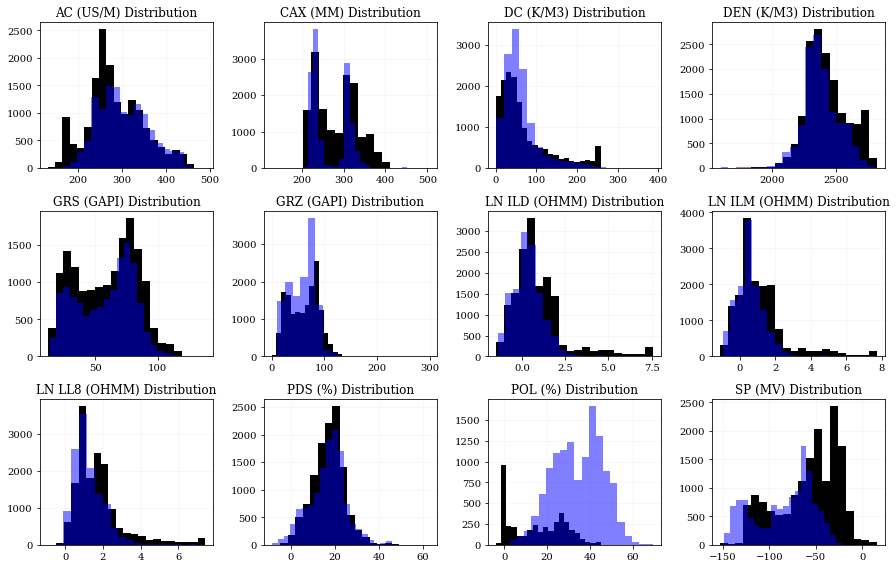

In [104]:
data_sample=L30_logs_Pressure
data_sample_2=B41_logs_pressure

data_sample=data_sample.loc[(data_sample['DC (K/M3)']>0)]
data_sample['LN ILD (OHMM)']= np.log(data_sample['ILD (OHMM)'])
data_sample['LN ILM (OHMM)']= np.log(data_sample['ILM (OHMM)'])
data_sample['LN LL8 (OHMM)']= np.log(data_sample['LL8 (OHMM)'])

data_sample['FACIES']=0
for i in data_sample.index:
    if data_sample['GRS (GAPI)'][i]<=30:
        data_sample['FACIES'][i]=30000 
    elif data_sample['GRS (GAPI)'][i]>30 and data_sample['GRS (GAPI)'][i]<=60:
        data_sample['FACIES'][i]=65030
    elif data_sample['GRS (GAPI)'][i]>60 and data_sample['GRS (GAPI)'][i]<=90:
        data_sample['FACIES'][i]=65000        
    elif data_sample['GRS (GAPI)'][i]>90:
        data_sample['FACIES'][i]=80000


data_sample_2=data_sample_2.loc[(data_sample_2['DC (K/M3)']>0)]
data_sample_2['LN ILD (OHMM)']= np.log(data_sample_2['ILD (OHMM)'])
data_sample_2['LN ILM (OHMM)']= np.log(data_sample_2['ILM (OHMM)'])
data_sample_2['LN LL8 (OHMM)']= np.log(data_sample_2['LL8 (OHMM)'])

data_sample_2['FACIES']=0
for i in data_sample_2.index:
    if data_sample_2['GRS (GAPI)'][i]<=30:
        data_sample_2['FACIES'][i]=30000 
    elif data_sample_2['GRS (GAPI)'][i]>30 and data_sample_2['GRS (GAPI)'][i]<=60:
        data_sample_2['FACIES'][i]=65030
    elif data_sample_2['GRS (GAPI)'][i]>60 and data_sample_2['GRS (GAPI)'][i]<=90:
        data_sample_2['FACIES'][i]=65000        
    elif data_sample_2['GRS (GAPI)'][i]>90:
        data_sample_2['FACIES'][i]=80000

cols_to_plot = list(['DEPT (M)', 'AC (US/M)', 'CAX (MM)', 'DC (K/M3)', 'DEN (K/M3)',
                     'GRS (GAPI)', 'GRZ (GAPI)', 'LN ILD (OHMM)', 'LN ILM (OHMM)', 'LN LL8 (OHMM)',
                     'PDS (%)', 'POL (%)', 'SP (MV)'])


cols_to_plot.remove('DEPT (M)')
#cols_to_plot.remove('PDL (%)')

#Setup the number of rows and columns for our plot
rows = 3
cols = 4

fig=plt.figure(figsize=(12.5,8))


for i, feature in enumerate(cols_to_plot):
    ax=fig.add_subplot(rows,cols,i+1)
    data_sample[feature].hist(bins=20,ax=ax,facecolor='black', alpha=1, )
    data_sample_2[feature].hist(bins=20,ax=ax,facecolor='blue', alpha=0.5)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    ax.grid(color='whitesmoke')

plt.tight_layout()  
plt.show()


In [107]:
# Mapping the data to the code
lithology_numbers = {30000: 'Sandstone',
                 65030: 'Sandstone/Shale',
                 65000: 'Shale',
                 80000: 'Marl',
                 74000: 'Dolomite',
                 70000: 'Limestone',
                 70032: 'Chalk',
                 88000: 'Halite',
                 86000: 'Anhydrite',
                 99000: 'Tuff',
                 90000: 'Coal',
                 93000: 'Basement',
                    0: 'Non-Identified'}

# One hot encoding
simple_lithology_numbers = {
                0:0,
                30000: 1,
                 65030: 2,
                 65000: 3,
                 80000: 4,
                 74000: 5,
                 70000: 6,
                 70032: 7,
                 88000: 8,
                 86000: 9,
                 99000: 10,
                 90000: 11,
                 93000: 12}

# Mapping the attributed classes
data_sample['LITH'] = data_sample['FACIES'].map(lithology_numbers)
data_sample_2['LITH'] = data_sample_2['FACIES'].map(lithology_numbers)

data_sample['LITH_SI'] = data_sample['FACIES'].map(simple_lithology_numbers)
data_sample_2['LITH_SI'] = data_sample_2['FACIES'].map(simple_lithology_numbers)

#data_sample['LITH_SI'].dropna(inplace=True)
#data_sample_2['LITH_SI'].dropna(inplace=True)

data_sample.loc[data_sample["Formation"].isna(), "Formation"]='Non-Identified'
data_sample_2.loc[data_sample_2["Formation"].isna(), "Formation"]='Non-Identified'

#data_sample.loc[data_sample["LITH_SI"]==2.0, "LITH_SI"]=2
#data_sample.loc[data_sample["LITH_SI"]==3.0, "LITH_SI"]=3
#data_sample.loc[data_sample["LITH_SI"]==4.0, "LITH_SI"]=4


#data_sample["LITH_SI"] = data_sample["LITH_SI"].astype(int)
#data_sample_2["LITH_SI"] = data_sample_2["LITH_SI"].astype(int)

data_sample

,DEPT (M),AC (US/M),ACL (US/M),CALS (MM),CAX (MM),DC (K/M3),DEN (K/M3),GRS (GAPI),GRZ (GAPI),ILD (OHMM),...,POS (%),SP (MV),Pressure (KPA),Formation,LN ILD (OHMM),LN ILM (OHMM),LN LL8 (OHMM),FACIES,LITH,LITH_SI
3009,932.4,454.7440,323.8181,304.6184,334.3698,19.7724,2005.6033,31.5187,34.1490,1.2661,...,56.9733,-46.4925,NaN,Wyandot,0.235941,0.295129,0.223064,65030,Sandstone/Shale,2
3010,932.6,397.0582,308.2006,306.0851,343.4746,8.7696,2038.0999,31.0836,35.6844,1.5050,...,51.8357,-46.0632,NaN,Wyandot,0.408793,0.495671,0.505491,65030,Sandstone/Shale,2
3011,932.8,366.1666,303.5962,307.0383,358.8392,25.5780,2084.3674,32.5875,37.2198,1.7885,...,50.9597,-45.1756,NaN,Wyandot,0.581377,0.709955,0.784130,65030,Sandstone/Shale,2
3012,933.0,360.5646,295.7245,306.8248,368.2364,33.6701,2103.0371,35.0695,38.8045,2.1439,...,51.2144,-44.4311,NaN,Wyandot,0.762627,0.908138,1.078205,65030,Sandstone/Shale,2
3013,933.2,359.6604,292.5966,306.6248,370.7031,38.1068,2093.4482,34.1961,40.5120,2.5368,...,51.6258,-43.9234,NaN,Wyandot,0.930903,1.000742,1.213963,65030,Sandstone/Shale,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19605,4248.8,NaN,NaN,202.7890,226.1178,109.6577,2640.3259,NaN,0.2660,5.2299,...,NaN,-27.2364,NaN,Non-Identified,1.654392,1.755597,2.264696,0,Non-Identified,0
19606,4249.0,NaN,NaN,202.7410,224.5178,99.5738,2655.7380,NaN,0.2463,5.0773,...,NaN,-26.9191,NaN,Non-Identified,1.624780,1.666631,2.266512,0,Non-Identified,0
19607,4249.2,NaN,NaN,203.1636,223.1382,79.5527,2655.8447,NaN,0.2267,4.9925,...,NaN,-27.0803,NaN,Non-Identified,1.607937,1.598337,2.082724,0,Non-Identified,0
19608,4249.4,NaN,NaN,203.2000,221.9382,93.0184,2652.6389,NaN,0.2070,4.9266,...,NaN,-27.6194,NaN,Non-Identified,1.594649,1.577328,1.910372,0,Non-Identified,0


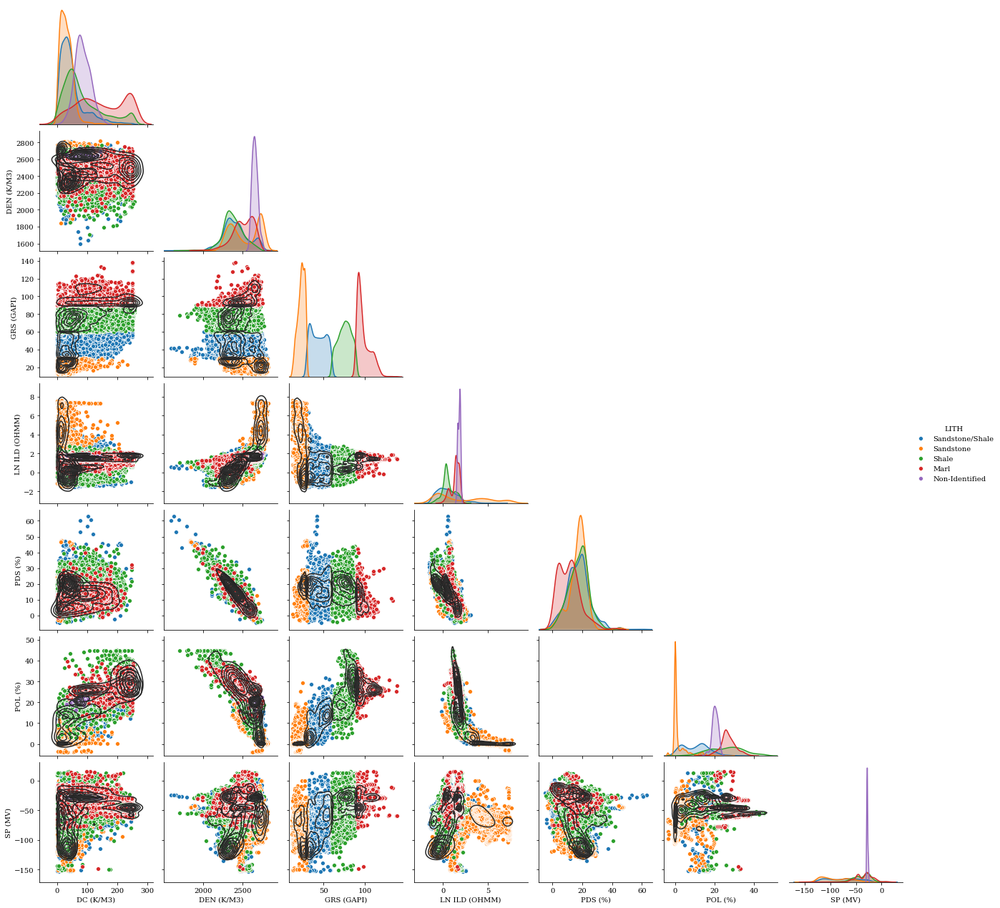

In [102]:
cols_to_plot = list(['DC (K/M3)', 'DEN (K/M3)', 'GRS (GAPI)', 'LN ILD (OHMM)',
                     'PDS (%)', 'POL (%)', 'SP (MV)','LITH','Formation'])

g = sns.pairplot(data_sample[cols_to_plot], diag_kind="kde", corner=True, hue='LITH')
g.map_lower(sns.kdeplot, levels=6, color=".2")

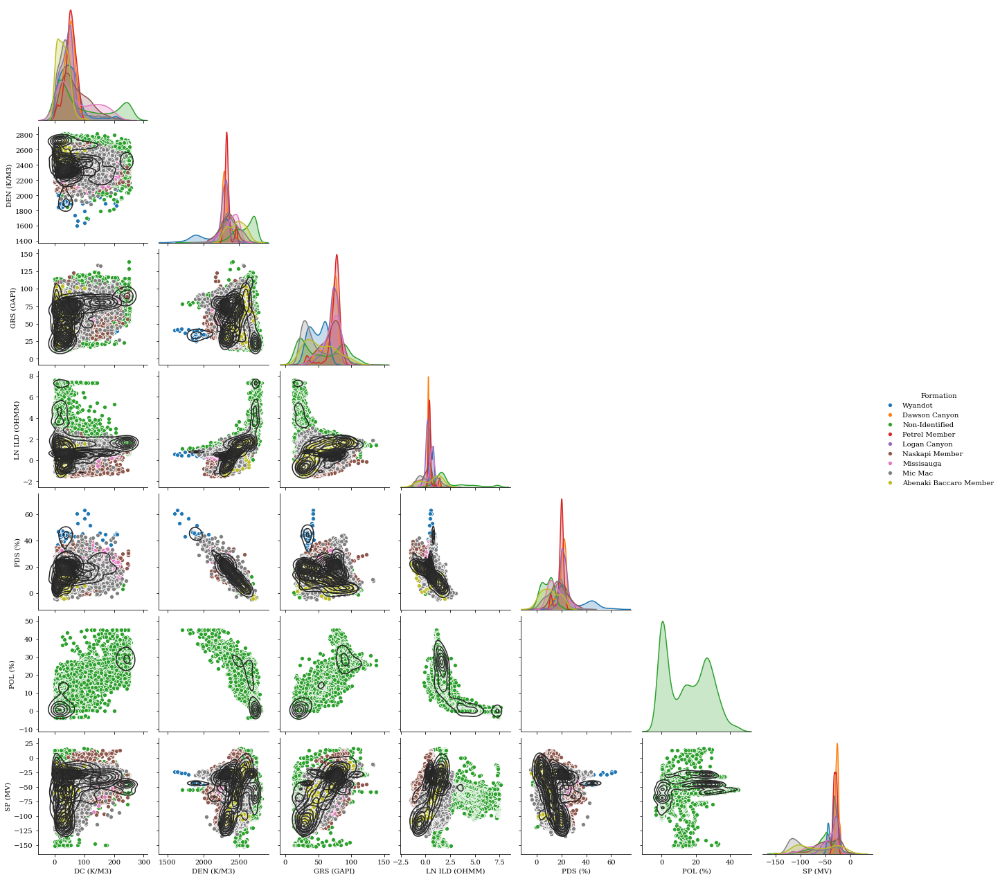

In [124]:
cols_to_plot = list(['DC (K/M3)', 'DEN (K/M3)', 'GRS (GAPI)', 'LN ILD (OHMM)',
                     'PDS (%)', 'POL (%)', 'SP (MV)','LITH','Formation'])

g = sns.pairplot(data_sample[cols_to_plot], diag_kind="kde", corner=True, hue='Formation')
g.map_lower(sns.kdeplot, levels=6, color=".2")

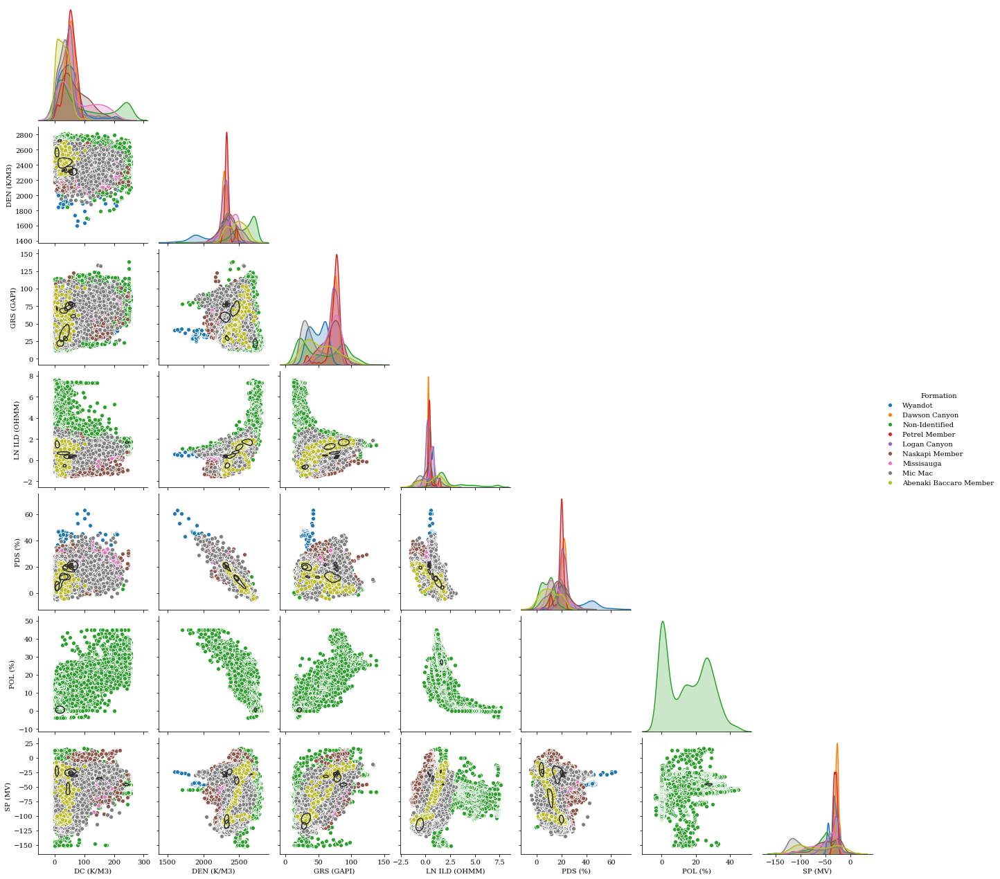

In [126]:
cols_to_plot = list(['DC (K/M3)', 'DEN (K/M3)', 'GRS (GAPI)', 'LN ILD (OHMM)',
                     'PDS (%)', 'POL (%)', 'SP (MV)','LITH','Formation'])

g = sns.pairplot(data_sample[cols_to_plot], diag_kind="kde", corner=True, hue='Formation')
g.map_lower(sns.kdeplot,levels=0, color=".2")

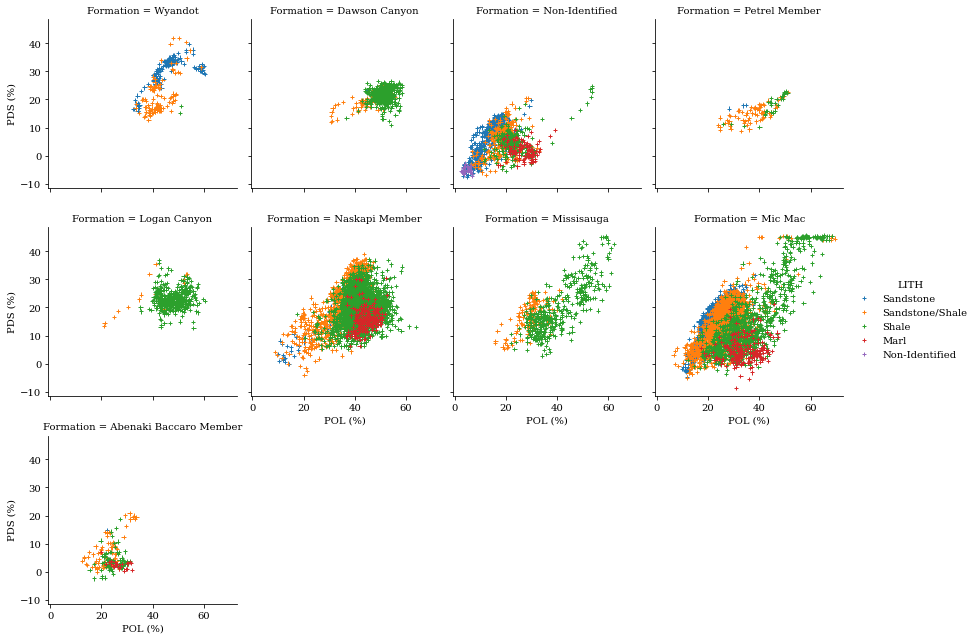

In [123]:
# Use the corresponding formation in the dicts in place of group
g = sns.FacetGrid(data_sample_2[cols_to_plot], col='Formation', hue='LITH', col_wrap=4)
g.map(sns.scatterplot,'POL (%)', 'PDS (%)',data=data_sample_2[cols_to_plot], linewidth=1, size=0.1, marker='+')
#g.set(xlim=(-0., 1))
#g.set(ylim=(3, 1))
g.add_legend()

In [ ]:
# 10 If you wanna identify bad hole data

In [4]:
WELL_B41= pd.read_csv('WELL_B41.csv')
WELL_L30= pd.read_csv('WELL_L30.csv')
Combined_data=pd.read_csv('Combined_wells_data.csv')

<AxesSubplot:>

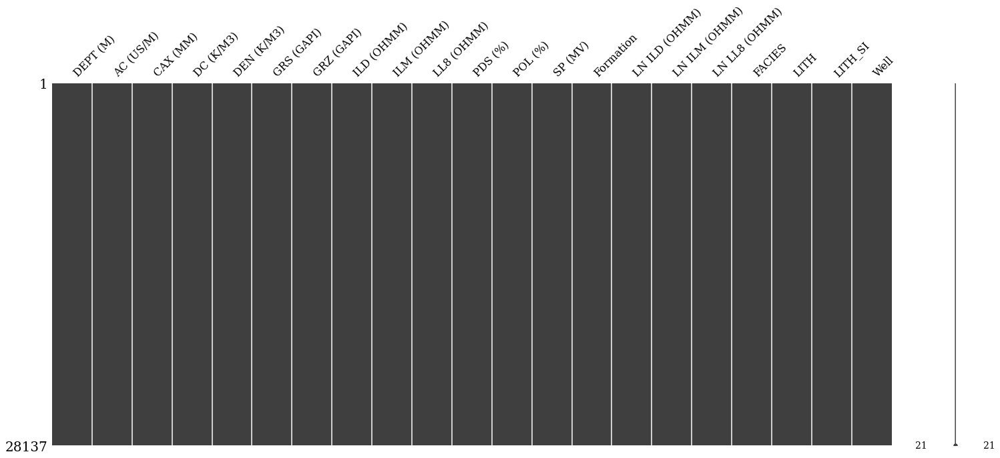

In [5]:
Combined_data.dropna(inplace=True)
msno.matrix(Combined_data)

<AxesSubplot:>

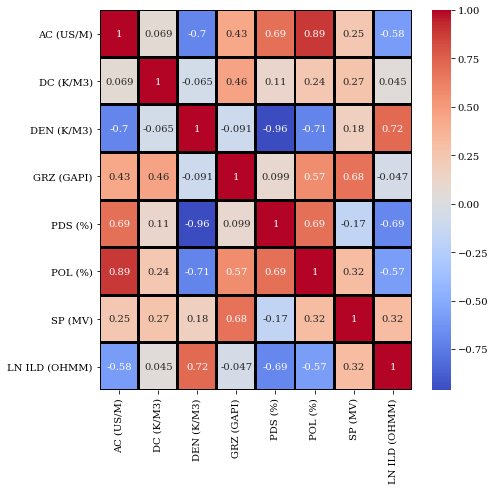

In [6]:
Data_for_heat_plot=Combined_data.drop(['FACIES', 'LITH', 'LITH_SI', 'DEPT (M)', 'Formation', 'CAX (MM)', 'Well',
                                       'ILD (OHMM)','ILM (OHMM)', 'LL8 (OHMM)', 'GRS (GAPI)',
                                      'LN ILM (OHMM)', 'LN LL8 (OHMM)'], axis=1)
fig=plt.figure(figsize=(7,7))
sns.heatmap(Data_for_heat_plot.corr(), cmap='coolwarm', annot=True, linewidths=2, linecolor='black')

In [7]:
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

In [8]:
Combined_data.dropna(inplace=True)
data_ML=Combined_data.drop(['FACIES', 'LITH', 'LITH_SI', 'DEPT (M)', 'Formation', 'CAX (MM)','Well',
                                       'ILD (OHMM)','ILM (OHMM)', 'LL8 (OHMM)', 'GRS (GAPI)',
                                      'LN ILM (OHMM)', 'LN LL8 (OHMM)'], axis=1)

data_ML.reset_index(inplace=True)
Combined_data.reset_index(inplace=True)

data_ML.drop('index', axis=1, inplace=True)
Combined_data.drop('index', axis=1, inplace=True)

In [9]:
def optimise_k_means(data, max_k):
    means = []
    inertias = []
    
    for k in range(1,max_k):
        kmeans = KMeans(n_clusters=k)
        kmeans.fit(data)
        means.append(k)
        inertias.append(kmeans.inertia_)
        
    fig = plt.subplots(figsize=(8, 5))
    plt.plot(means, inertias, 'o-')
    plt.xlabel("Number of Clusters")
    plt.ylabel("Inertia")
    plt.grid(True)
    plt.show()
    
data_ML.dropna(inplace=True)

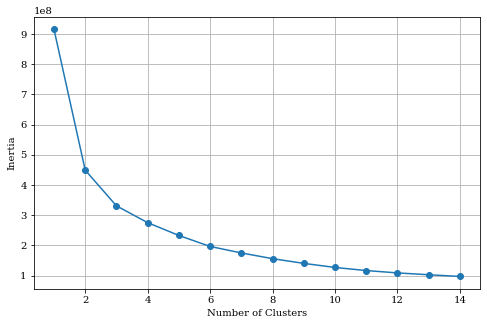

In [10]:
optimise_k_means(data_ML, 15)

In [11]:
# Create the KMeans model with the selected number of clusters
kmeans = KMeans(n_clusters=4)

# Fit the model to our dataset
kmeans.fit(data_ML)

# Assign the data back to the workingdf
data_ML['KMeans'] = kmeans.labels_

In [12]:
# Create the gmm model with the selected number of clusters/components
gmm = GaussianMixture(n_components=4)

# Fit the model to our dataset
gmm.fit(data_ML)

# Predict the labels
gmm_labels = gmm.predict(data_ML)

# Assign the labels back to the workingdf
data_ML['GMM'] = gmm_labels

In [13]:
data_ML

,AC (US/M),DC (K/M3),DEN (K/M3),GRZ (GAPI),PDS (%),POL (%),SP (MV),LN ILD (OHMM),KMeans,GMM
0,338.9702,13.6378,2007.8229,25.4502,36.2897,55.6330,-36.5391,0.381855,0,3
1,343.7549,128.9239,2069.4744,26.6372,39.7858,54.0696,-37.5425,0.388726,0,3
2,347.1716,124.0577,2135.7900,26.0677,37.7485,55.6355,-39.3006,0.391028,0,3
3,348.3606,126.1102,2170.1812,25.7850,31.1529,58.5188,-39.7038,0.384241,0,3
4,348.6413,121.1758,2174.9055,25.7236,29.0948,60.2331,-38.8098,0.360119,0,3
...,...,...,...,...,...,...,...,...,...,...
28132,256.1387,64.8606,2631.9590,104.1965,6.3273,25.3677,-30.5731,1.381131,3,1
28133,257.2060,60.1740,2622.6362,105.0430,5.3037,25.4700,-30.3369,1.397704,3,1
28134,255.1202,57.5388,2617.2202,105.8546,4.6764,25.6049,-30.1335,1.415829,3,1
28135,255.8755,72.7803,2602.2678,106.4127,5.2253,25.8732,-30.2178,1.433941,3,1


In [14]:
Combined_data

,DEPT (M),AC (US/M),CAX (MM),DC (K/M3),DEN (K/M3),GRS (GAPI),GRZ (GAPI),ILD (OHMM),ILM (OHMM),LL8 (OHMM),...,POL (%),SP (MV),Formation,LN ILD (OHMM),LN ILM (OHMM),LN LL8 (OHMM),FACIES,LITH,LITH_SI,Well
0,919.8,338.9702,414.9646,13.6378,2007.8229,28.8639,25.4502,1.4650,1.6523,1.8762,...,55.6330,-36.5391,Wyandot,0.381855,0.502168,0.629248,30000,Sandstone,1,L30
1,920.0,343.7549,430.4579,128.9239,2069.4744,29.2415,26.6372,1.4751,1.6325,1.7781,...,54.0696,-37.5425,Wyandot,0.388726,0.490113,0.575545,30000,Sandstone,1,L30
2,920.2,347.1716,439.6146,124.0577,2135.7900,28.1575,26.0677,1.4785,1.6120,1.6666,...,55.6355,-39.3006,Wyandot,0.391028,0.477476,0.510786,30000,Sandstone,1,L30
3,920.4,348.3606,443.2046,126.1102,2170.1812,25.3289,25.7850,1.4685,1.5631,1.6781,...,58.5188,-39.7038,Wyandot,0.384241,0.446671,0.517662,30000,Sandstone,1,L30
4,920.6,348.6413,444.0886,121.1758,2174.9055,24.5328,25.7236,1.4335,1.5174,1.6870,...,60.2331,-38.8098,Wyandot,0.360119,0.416998,0.522952,30000,Sandstone,1,L30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28132,4237.2,256.1387,235.9990,64.8606,2631.9590,108.8919,104.1965,3.9794,4.1110,5.1365,...,25.3677,-30.5731,Non-Identified,1.381131,1.413666,1.636372,80000,Marl,4,B41
28133,4237.4,257.2060,236.6032,60.1740,2622.6362,113.3078,105.0430,4.0459,4.1210,5.2242,...,25.4700,-30.3369,Non-Identified,1.397704,1.416096,1.653302,80000,Marl,4,B41
28134,4237.6,255.1202,237.4032,57.5388,2617.2202,116.1959,105.8546,4.1199,4.1310,5.3134,...,25.6049,-30.1335,Non-Identified,1.415829,1.418520,1.670232,80000,Marl,4,B41
28135,4237.8,255.8755,238.1190,72.7803,2602.2678,113.8643,106.4127,4.1952,4.2060,5.4041,...,25.8732,-30.2178,Non-Identified,1.433941,1.436512,1.687158,80000,Marl,4,B41


In [15]:
data_ML['LITH_SI']=Combined_data['LITH_SI']
data_ML['Well']=Combined_data['Well']
data_ML['DEPT (M)']=Combined_data['DEPT (M)']
data_ML['LITHOLOGY']=Combined_data['FACIES']

data_ML

,AC (US/M),DC (K/M3),DEN (K/M3),GRZ (GAPI),PDS (%),POL (%),SP (MV),LN ILD (OHMM),KMeans,GMM,LITH_SI,Well,DEPT (M),LITHOLOGY
0,338.9702,13.6378,2007.8229,25.4502,36.2897,55.6330,-36.5391,0.381855,0,3,1,L30,919.8,30000
1,343.7549,128.9239,2069.4744,26.6372,39.7858,54.0696,-37.5425,0.388726,0,3,1,L30,920.0,30000
2,347.1716,124.0577,2135.7900,26.0677,37.7485,55.6355,-39.3006,0.391028,0,3,1,L30,920.2,30000
3,348.3606,126.1102,2170.1812,25.7850,31.1529,58.5188,-39.7038,0.384241,0,3,1,L30,920.4,30000
4,348.6413,121.1758,2174.9055,25.7236,29.0948,60.2331,-38.8098,0.360119,0,3,1,L30,920.6,30000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28132,256.1387,64.8606,2631.9590,104.1965,6.3273,25.3677,-30.5731,1.381131,3,1,4,B41,4237.2,80000
28133,257.2060,60.1740,2622.6362,105.0430,5.3037,25.4700,-30.3369,1.397704,3,1,4,B41,4237.4,80000
28134,255.1202,57.5388,2617.2202,105.8546,4.6764,25.6049,-30.1335,1.415829,3,1,4,B41,4237.6,80000
28135,255.8755,72.7803,2602.2678,106.4127,5.2253,25.8732,-30.2178,1.433941,3,1,4,B41,4237.8,80000


In [16]:
L30=data_ML.loc[(data_ML.Well=='L30')]
B41=data_ML.loc[(data_ML.Well=='B41')]

In [13]:
B41.GMM.value_counts()

0    5746
2    5250
1    3559
3    1094
Name: GMM, dtype: int64

In [25]:
def compar_graph(par_1,par_2):
    fig, ax = plt.subplots(figsize=(15,6))
    ax1 = plt.subplot2grid((1,3), (0,0))
    ax1.scatter(data_ML[str(par_1)], data_ML[str(par_2)], c=data_ML['KMeans'], s=8)
    ax1.set_title('KMeans', fontsize=16, y=1.05)

    ax2 = plt.subplot2grid((1,3), (0,1))
    ax2.scatter(data_ML[str(par_1)], data_ML[str(par_2)], c=data_ML['GMM'], s=8)
    ax2.set_title('GMM', fontsize=16, y=1.05)

    ax3 = plt.subplot2grid((1,3), (0,2))
    ax3.scatter(data_ML[str(par_1)], data_ML[str(par_2)], c=Combined_data['LITH_SI'], s=8)
    ax3.set_title('GR Based Separation', fontsize=16, y=1.05)

    for ax in [ax1, ax2, ax3]:
        #ax.set_xlim(0, 0.7)
        #ax.set_ylim(3, 1.5)
        ax.set_ylabel(str(par_2), fontsize=14, labelpad=30)
        ax.set_xlabel(str(par_1), fontsize=14, labelpad=30)
        ax.grid()
        ax.set_axisbelow(True)

        ax.tick_params(axis='both', labelsize=12)
    plt.tight_layout()

In [310]:
data_ML.columns

Index(['AC (US/M)', 'DC (K/M3)', 'DEN (K/M3)', 'GRZ (GAPI)', 'PDS (%)',
       'POL (%)', 'SP (MV)', 'LN ILD (OHMM)', 'KMeans', 'GMM', 'LITH_SI',
       'Well', 'DEPT (M)', 'LITHOLOGY'],
      dtype='object')

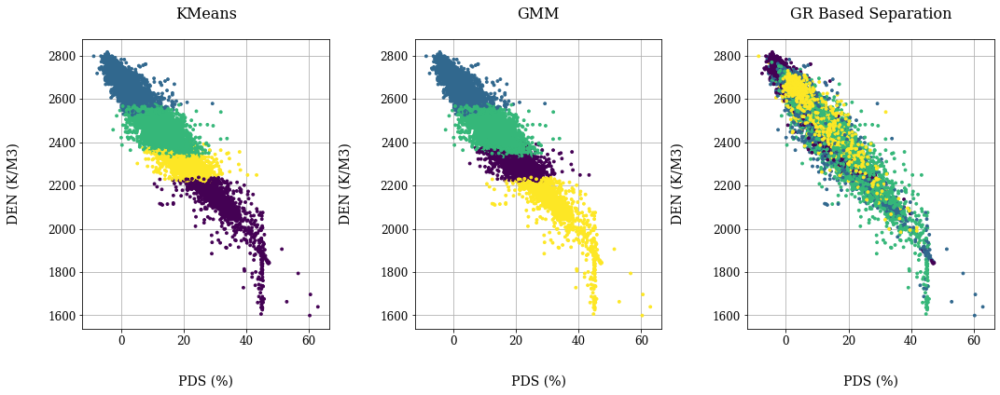

In [26]:
compar_graph('PDS (%)', 'DEN (K/M3)')

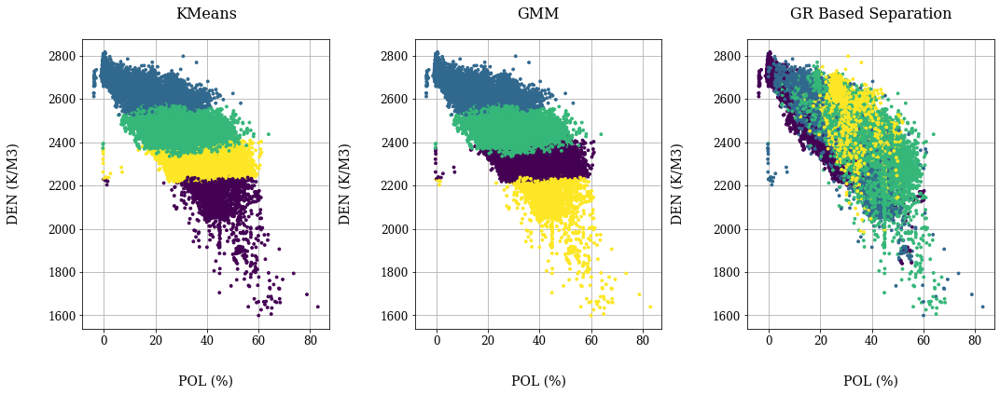

In [27]:
compar_graph('POL (%)', 'DEN (K/M3)')

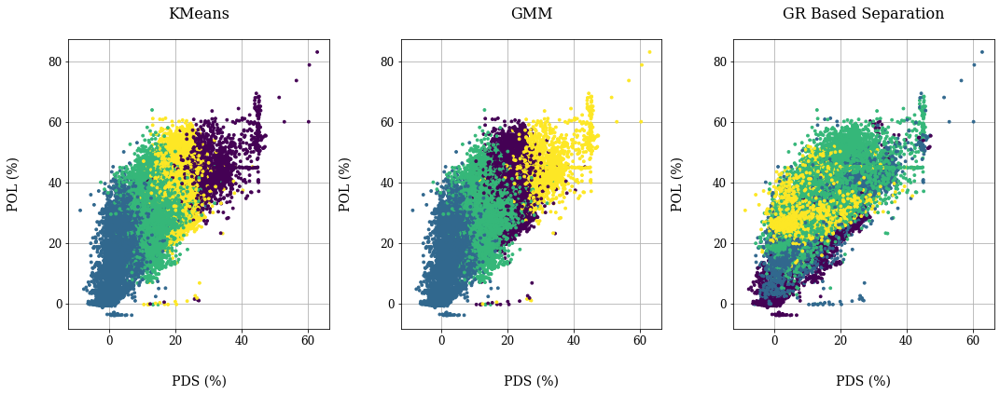

In [28]:
compar_graph('PDS (%)','POL (%)')


In [78]:
import matplotlib
#matplotlib.rcsetup.interactive_bk
#matplotlib.rcsetup.non_interactive_bk
#matplotlib.rcsetup.all_backends

from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D

def ml_plot(data, x, y, z, c, tit):
    fig = pyplot.figure(figsize=(7,7))
    ax = Axes3D(fig)
    cax=ax.scatter(data[x], data[y], data[z], c=data[c], marker='o')

    ax.set_xlabel(x)
    ax.set_ylabel(y)
    ax.set_zlabel(z)
    #ax.set_title(tit)
    #ax.legend(loc="best")
    #cbar1 = fig.colorbar(cax,  orientation='horizontal')
    #cbar1.ax.set_xticklabels(['Problematic', 'High', 'Bad', 'Moderate', 'Best'])  # horizontal colorbar

    pyplot.show()

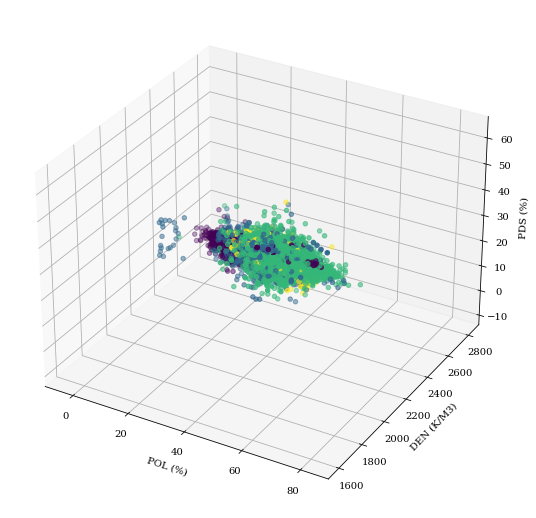

In [79]:
ml_plot(data_ML,'POL (%)', 'DEN (K/M3)', 'PDS (%)','LITH_SI','GR Based Clusted')

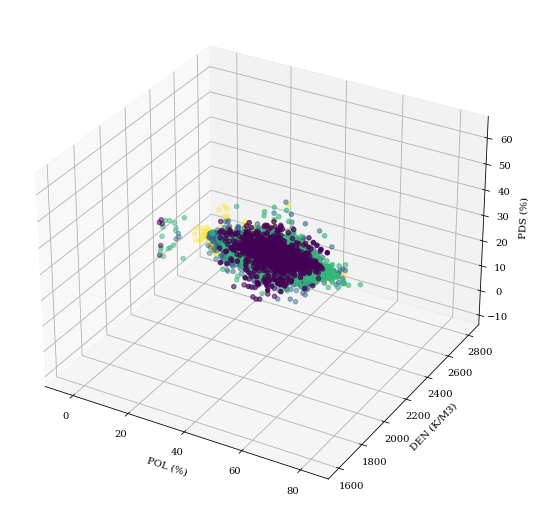

In [80]:
ml_plot(data_ML,'POL (%)', 'DEN (K/M3)', 'PDS (%)','KMeans','Kmeans')

In [17]:
data_ML.columns

Index(['AC (US/M)', 'DC (K/M3)', 'DEN (K/M3)', 'GRZ (GAPI)', 'PDS (%)',
       'POL (%)', 'SP (MV)', 'LN ILD (OHMM)', 'KMeans', 'GMM', 'LITH_SI',
       'Well', 'DEPT (M)', 'LITHOLOGY'],
      dtype='object')

In [87]:
import plotly.express as px
import plotly.graph_objects as go 

def int_fig(data, x,y,z,color,tit,s):
    # 3D visual and hover source
    Hover_fig = go.Figure()
    Hover_fig = px.scatter_3d(data, x=x, y=y, z=z, color=color,size_max=s,
                       opacity=0.7,
                       title=tit)
    x_eye = -1.25
    y_eye = 2
    z_eye = 0.5 

    
    
    Hover_fig.update_layout(
             title='Animation Test',
             width=600,
             height=600,
             scene_camera_eye=dict(x=x_eye, y=y_eye, z=z_eye),
             updatemenus=[dict(type='buttons',
                      showactive=True,
                      y=1,
                      x=0.8,
                      xanchor='left',
                      yanchor='bottom',
                      pad=dict(t=45, r=10),
                      buttons=[dict(label='Play',
                                     method='animate',
                                     args=[None, dict(frame=dict(duration=5, redraw=True), 
                                                                 transition=dict(duration=0),
                                                                 fromcurrent=True,
                                                                 mode='immediate'
                                                                )]
                                                )
                                          ]
                                  )
                            ]
    )
    
    def rotate_z(x, y, z, theta):
        w = x+1j*y
        return np.real(np.exp(1j*theta)*w), np.imag(np.exp(1j*theta)*w), z

    frames=[]
    for t in np.arange(0, 6.26, 0.1):
        xe, ye, ze = rotate_z(x_eye, y_eye, z_eye, -t)
        frames.append(go.Frame(layout=dict(scene_camera_eye=dict(x=xe, y=ye, z=ze))))
    fig.frames=frames

    #Hover_fig.update_layout(template="plotly_dark")

    Hover_fig.show()

In [ ]:
int_fig(data_ML,'POL (%)', 'DEN (K/M3)', 'PDS (%)','LITH_SI','GR Based Clusted',10)

In [111]:
Kmean_litho={0:{'color':'#F4D03F'},
            1:{'color':'#F5B041'},
            2:{'color':'#DC7633'},
            3:{'color':'#6E2C00'}}

GMM_litho={
            0:{'color':'#1B4F72'},
            1:{'color':'#2E86C1'},
            2:{'color':'#AED6F1'},
            3:{'color':'#A569BD'}}

In [112]:
lithology_numbers = {30000: {'lith':'Sandstone', 'lith_num':1, 'hatch': '..', 'color':'#ffff00'},
                 65030: {'lith':'Sandstone/Shale', 'lith_num':2, 'hatch':'-.', 'color':'#ffe119'},
                 65000: {'lith':'Shale', 'lith_num':3, 'hatch':'--', 'color':'#bebebe'},
                 80000: {'lith':'Marl', 'lith_num':4, 'hatch':'', 'color':'#7cfc00'},
                 74000: {'lith':'Dolomite', 'lith_num':5, 'hatch':'-/', 'color':'#8080ff'},
                 70000: {'lith':'Limestone', 'lith_num':6, 'hatch':'+', 'color':'#80ffff'},
                 70032: {'lith':'Chalk', 'lith_num':7, 'hatch':'..', 'color':'#80ffff'},
                 88000: {'lith':'Halite', 'lith_num':8, 'hatch':'x', 'color':'#7ddfbe'},
                 86000: {'lith':'Anhydrite', 'lith_num':9, 'hatch':'', 'color':'#ff80ff'},
                 99000: {'lith':'Tuff', 'lith_num':10, 'hatch':'||', 'color':'#ff8c00'},
                 90000: {'lith':'Coal', 'lith_num':11, 'hatch':'', 'color':'black'},
                 93000: {'lith':'Basement', 'lith_num':12, 'hatch':'-|', 'color':'#ef138a'}}

df_lith = pd.DataFrame.from_dict(lithology_numbers, orient='index')
df_lith.index.name = 'LITHOLOGY'

In [113]:
# Final plot
def log(well_name, data_sample, max_depth, min_depth):
    fig, ax = plt.subplots(figsize=(25,100), sharey=True)

    #Set up the plot axes
    ax1 = plt.subplot2grid((1,9), (0,0), rowspan=1, colspan = 1)
    ax2 = plt.subplot2grid((1,9), (0,1), rowspan=1, colspan = 1)
    #ax3 = plt.subplot2grid((1,10), (0,2), rowspan=1, colspan = 1)
    ax4 = plt.subplot2grid((1,9), (0,2), rowspan=1, colspan = 1)
    ax5 = plt.subplot2grid((1,9), (0,3), rowspan=1, colspan = 1)
    ax6 = plt.subplot2grid((1,9), (0,4), rowspan=1, colspan = 1)
    ax7 = plt.subplot2grid((1,9), (0,5), rowspan=1, colspan = 1)
    ax14 = plt.subplot2grid((1,9), (0,6), rowspan=1, colspan = 1) #Litho
    ax16 = plt.subplot2grid((1,9), (0,7), rowspan=1, colspan = 1) #Litho
    ax17 = plt.subplot2grid((1,9), (0,8), rowspan=1, colspan = 1) #Litho


    #ax4 = ax2.twiny() #Twins the y-axis for the density track with the neutron track
    #ax8  = ax2.twiny() # 'GRZ (GAPI)'
    ax13 = ax2.twiny()
    ax9  = ax4.twiny()
    ax10 = ax5.twiny()
    #ax11 = ax5.twiny()
    ax12 = ax6.twiny()
    ax15 = ax14.twiny()
    ax61 = ax16.twiny()
    ax71 = ax17.twiny()


    # As our curve scales will be detached from the top of the track,
    # this code adds the top border back in without dealing with splines
    ax15 = ax1.twiny()
    ax15.xaxis.set_visible(False)
    ax20 = ax2.twiny()
    ax20.xaxis.set_visible(False)
    #ax30 = ax3.twiny()
    #ax30.xaxis.set_visible(False)
    ax40 = ax4.twiny()
    ax40.xaxis.set_visible(False)
    ax50 = ax5.twiny()
    ax50.xaxis.set_visible(False)
    ax60 = ax6.twiny()
    ax60.xaxis.set_visible(False)
    ax70 = ax7.twiny()
    ax70.xaxis.set_visible(False)

    # SP
    ax1.plot(data_sample['SP (MV)'], data_sample['DEPT (M)'], color = "blue",linewidth=2)
    ax1.set_xlabel("SPONTANEOUS POTENTIAL (MV)")
    ax1.xaxis.label.set_color("blue")
    ax1.set_xlim(data_sample['SP (MV)'].min(), data_sample['SP (MV)'].max())
    ax1.set_ylim(max_depth, min_depth)
    ax1.tick_params(axis='x', colors="blue")
    ax1.tick_params(axis='y', colors="black")
    ax1.spines["top"].set_edgecolor("blue")
    ax1.title.set_color('blue')


    # 'GRS (GAPI)'
    ax2.plot(data_sample['GRZ (GAPI)'], data_sample['DEPT (M)'], color = "green", linestyle='dashed', linewidth=1)
    ax2.set_xlabel("GAMMA RAY (GAPI)")
    ax2.xaxis.label.set_color("green")
    ax2.set_xlim(data_sample['GRZ (GAPI)'].min(), data_sample['GRZ (GAPI)'].max())
    ax2.set_ylim(max_depth, min_depth)
    ax2.tick_params(axis='x', colors="green")
    ax2.tick_params(axis='y', colors="black")
    ax2.spines["top"].set_edgecolor("green")
    ax2.title.set_color('green')




    # 'DC (K/M3)'
    ax4.plot(data_sample['DC (K/M3)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
    ax4.set_xlabel("DENSITY CORRECTION (K/M3)")
    ax4.set_xlim(data_sample['DC (K/M3)'].min(), data_sample['DC (K/M3)'].max())
    ax4.set_ylim(max_depth, min_depth)
    ax4.xaxis.label.set_color("black")
    ax4.tick_params(axis='x', colors="black")
    ax4.tick_params(axis='y', colors="black")
    ax4.spines["top"].set_edgecolor("black")



    # 'ILD (OHMM)'
    ax5.plot(data_sample['LN ILD (OHMM)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
    ax5.set_xlabel("DEEP INDUCTION (OHMM)")
    ax5.set_xlim(data_sample['LN ILD (OHMM)'].min(), data_sample['LN ILD (OHMM)'].max())
    ax5.set_ylim(max_depth, min_depth)
    ax5.xaxis.label.set_color("black")
    ax5.tick_params(axis='x', colors="black")
    ax5.tick_params(axis='y', colors="black")
    ax5.spines["top"].set_edgecolor("black")


    # PDS
    ax6.plot(data_sample['PDS (%)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
    ax6.set_xlabel("DENSITY POROSITY (SANDSTONE)")
    ax6.set_xlim(data_sample['PDS (%)'].min(), data_sample['PDS (%)'].max())
    ax6.set_ylim(max_depth, min_depth)
    ax6.xaxis.label.set_color("black")
    ax6.tick_params(axis='x', colors="black")
    ax6.tick_params(axis='y', colors="black")
    ax6.spines["top"].set_edgecolor("black")



    # 'AC (US/M)'
    ax7.plot(data_sample['AC (US/M)'], data_sample['DEPT (M)'], color = "black",linewidth=2)
    ax7.set_xlabel("TRANSIT TIME (COMPENSATED)")
    ax7.set_xlim(data_sample['AC (US/M)'].min(), data_sample['AC (US/M)'].max())
    ax7.set_ylim(max_depth, min_depth)
    ax7.xaxis.label.set_color("black")
    ax7.tick_params(axis='x', colors="black")
    ax7.tick_params(axis='y', colors="black")
    ax7.spines["top"].set_edgecolor("black")




    # 'DEN (K/M3)'
    ax9.plot(data_sample['DEN (K/M3)'], data_sample['DEPT (M)'], color = "red",linewidth=2)
    ax9.set_xlabel('BULK DENSITY (K/M3)')
    ax9.xaxis.label.set_color("red")
    ax9.set_xlim(data_sample['DEN (K/M3)'].min(), data_sample['DEN (K/M3)'].max())
    ax9.set_ylim(max_depth, min_depth)
    ax9.tick_params(axis='x', colors="red")
    ax9.spines["top"].set_position(("axes", 1.02))
    ax9.spines["top"].set_visible(True)
    ax9.spines["top"].set_edgecolor("red")
    #ax8.set_xticks([0.45,  0.15, -0.15])




    # 'POL (%)'
    ax12.plot(data_sample['POL (%)'], data_sample['DEPT (M)'], color = "blue",linewidth=1, linestyle='-')
    ax12.set_xlabel('NEUTRON POROSITY (LIMESTONE)')
    ax12.xaxis.label.set_color("blue")
    ax12.set_xlim(data_sample['POL (%)'].max(), data_sample['POL (%)'].min())
    ax12.set_ylim(max_depth, min_depth)
    ax12.tick_params(axis='x', colors="blue")
    ax12.spines["top"].set_position(("axes", 1.02))
    ax12.spines["top"].set_visible(True)
    ax12.spines["top"].set_edgecolor("blue")
    #ax12.invert_xaxis()
    #ax8.set_xticks([0.45,  0.15, -0.15])


    # Lithology track
    ax14.plot(data_sample.LITHOLOGY,data_sample['DEPT (M)'], color = "black", linewidth = 0.5)
    ax14.set_xlabel("Lithology")
    ax14.set_xlim(0, 1)
    ax14.set_ylim(max_depth, min_depth)
    ax14.xaxis.label.set_color("black")
    ax14.tick_params(axis='x', colors="black")
    ax14.spines["top"].set_edgecolor("black")

    for key in lithology_numbers.keys():
        color = lithology_numbers[key]['color']
        hatch = lithology_numbers[key]['hatch']
        ax14.fill_betweenx(data_sample['DEPT (M)'], 0, data_sample.LITHOLOGY, where=(data_sample.LITHOLOGY==key),
                         facecolor=color, hatch=hatch)
        
    # Kmeans
    ax16.plot(data_sample.KMeans,data_sample['DEPT (M)'], color = "black", linewidth = 0.5)
    ax16.set_xlabel("Kmeans")
    ax16.set_xlim(0, 1)
    ax16.set_ylim(max_depth, min_depth)
    ax16.xaxis.label.set_color("black")
    ax16.tick_params(axis='x', colors="black")
    ax16.spines["top"].set_edgecolor("black")

    for key in Kmean_litho.keys():
        color = Kmean_litho[key]['color']
        ax16.fill_betweenx(data_sample['DEPT (M)'], 0, data_sample.KMeans, where=(data_sample.KMeans==key),
                         facecolor=color)

    # GMM
    ax17.plot(data_sample.GMM,data_sample['DEPT (M)'], color = "black", linewidth = 0.5)
    ax17.set_xlabel("GMM")
    ax17.set_xlim(0, 1)
    ax17.set_ylim(max_depth, min_depth)
    ax17.xaxis.label.set_color("black")
    ax17.tick_params(axis='x', colors="black")
    ax17.spines["top"].set_edgecolor("black")

    for key in GMM_litho.keys():
        color = GMM_litho[key]['color']
        ax17.fill_betweenx(data_sample['DEPT (M)'], 0, data_sample.GMM, where=(data_sample.GMM==key),
                         facecolor=color)        
        
    # Filling the blank
    x1=data_sample['POL (%)']
    x2=data_sample['PDS (%)']

    x = np.array(ax12.get_xlim()) #pol
    z = np.array(ax6.get_xlim()) #pds

    nz=((x2-np.max(z))/(np.min(z)-np.max(z)))*(np.max(x)-np.min(x))+np.min(x)

    ax12.fill_betweenx(data_sample['DEPT (M)'], x1, nz, where=x1>=nz, interpolate=True, color='green')
    ax12.fill_betweenx(data_sample['DEPT (M)'], x1, nz, where=x1<=nz, interpolate=True, color='yellow')


    # Common functions for setting up the plot can be extracted into
    # a for loop. This saves repeating code.
    for ax in [ax1,ax2,ax4,ax5,ax6,ax7,ax14,ax16, ax17]:
        ax.grid(which='major', color='lightgrey', linestyle='-')
        ax.xaxis.set_ticks_position("top")
        ax.xaxis.set_label_position("top")
        ax.spines["top"].set_position(("axes", 1.01)) 

    fig.suptitle(well_name,fontsize=30, y=1.006)
    fig.tight_layout()
    

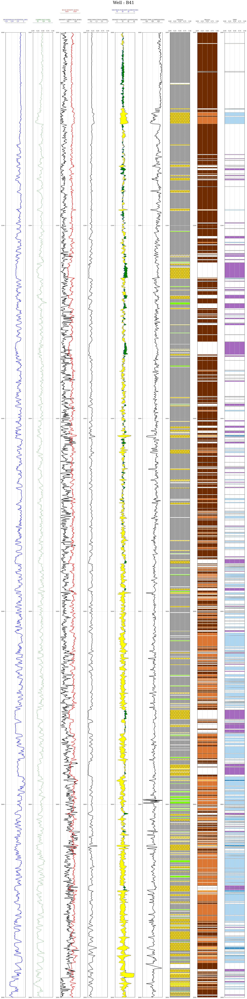

In [114]:
B41.reset_index(inplace=True)
B41.drop('index', inplace=True, axis=1)
log('Well : B41',B41,2000, 1000)

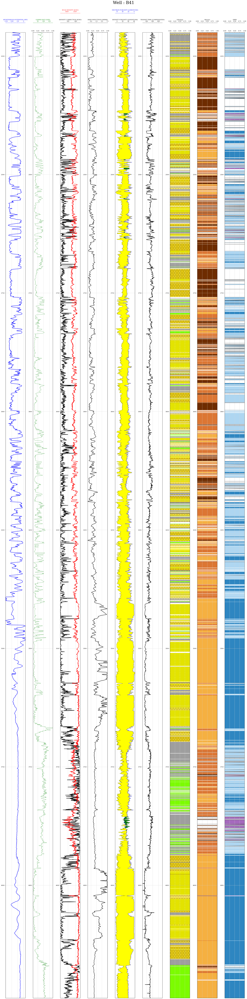

In [127]:
B41.reset_index(inplace=True)
B41.drop('index', inplace=True, axis=1)
log('Well : B41',B41,max(B41['DEPT (M)']), 2200)

In [19]:
L30.columns

Index(['AC (US/M)', 'DC (K/M3)', 'DEN (K/M3)', 'GRZ (GAPI)', 'PDS (%)',
       'POL (%)', 'SP (MV)', 'LN ILD (OHMM)', 'KMeans', 'GMM', 'LITH_SI',
       'Well', 'DEPT (M)', 'LITHOLOGY'],
      dtype='object')

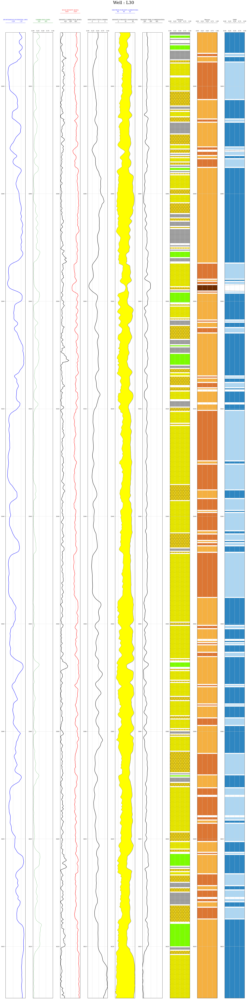

In [30]:
log('Well : L30',L30, max(L30['DEPT (M)']), 3250)

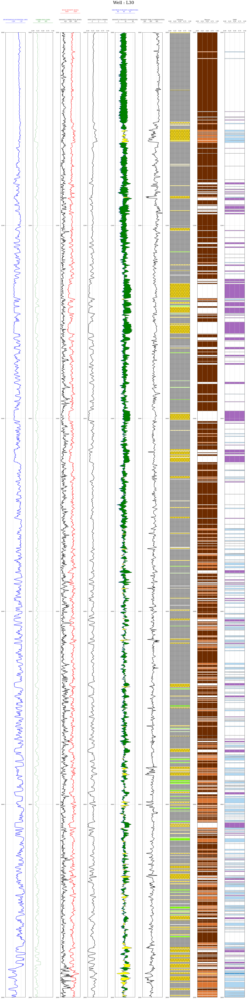

In [115]:
log('Well : L30',L30, 2000, 1000)

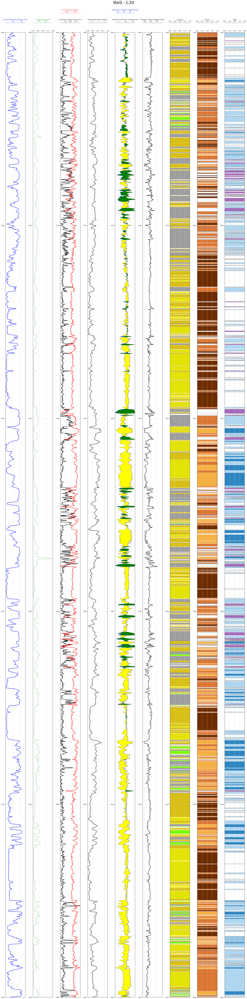

In [128]:
log('Well : L30',L30, 3000, 2000)

In [117]:
New_data=pd.read_csv('Complete_L30_log_LITHO.csv')

<AxesSubplot:>

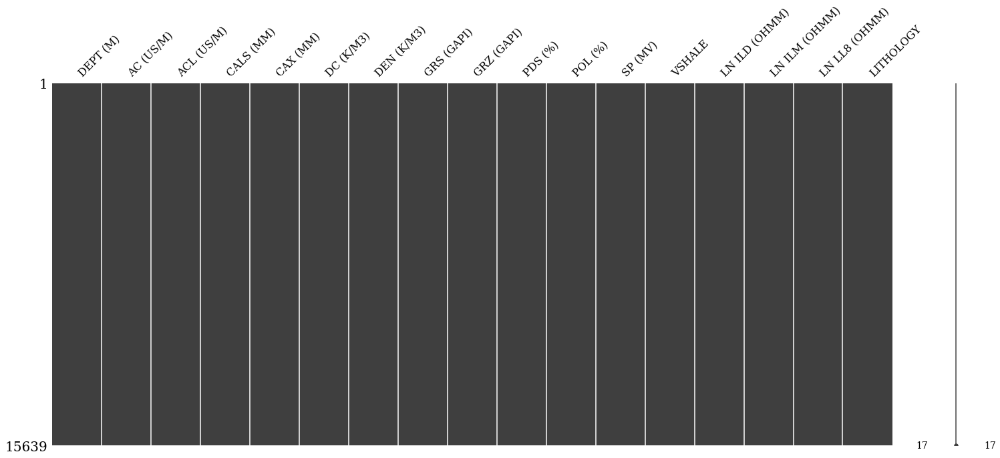

In [118]:
New_data.drop('Formation', axis=1, inplace=True)
New_data.dropna(inplace=True)
New_data.reset_index(inplace=True)
New_data.drop('index', axis=1, inplace=True)
msno.matrix(New_data)

In [119]:
ML_new_data=New_data.drop(['ACL (US/M)', 'CALS (MM)', 'LITHOLOGY', 'DEPT (M)', 'CAX (MM)', 'VSHALE', 'GRS (GAPI)',
                                      'LN ILM (OHMM)', 'LN LL8 (OHMM)'], axis=1)

In [120]:
ML_new_data.columns

Index(['AC (US/M)', 'DC (K/M3)', 'DEN (K/M3)', 'GRZ (GAPI)', 'PDS (%)',
       'POL (%)', 'SP (MV)', 'LN ILD (OHMM)'],
      dtype='object')

In [121]:
# Kmeans and GMM using L30 only
# Create the KMeans model with the selected number of clusters
kmeans = KMeans(n_clusters=4)

# Fit the model to our dataset
kmeans.fit(ML_new_data)

# Assign the data back to the workingdf
ML_new_data['KMeans'] = kmeans.labels_

In [122]:
# Create the gmm model with the selected number of clusters/components
gmm = GaussianMixture(n_components=4)

# Fit the model to our dataset
gmm.fit(ML_new_data)

# Predict the labels
gmm_labels = gmm.predict(ML_new_data)

# Assign the labels back to the workingdf
ML_new_data['GMM'] = gmm_labels

In [125]:
ML_new_data['DEPT (M)']=New_data['DEPT (M)']
ML_new_data['LITHOLOGY']=New_data['LITHOLOGY']
ML_new_data

,AC (US/M),DC (K/M3),DEN (K/M3),GRZ (GAPI),PDS (%),POL (%),SP (MV),LN ILD (OHMM),KMeans,GMM,DEPT (M),LITHOLOGY
0,454.7440,19.7724,2005.6033,34.1490,40.7832,56.9733,-46.4925,0.235941,1,0,932.4,65030.0
1,397.0582,8.7696,2038.0999,35.6844,36.6154,51.8357,-46.0632,0.408793,1,0,932.6,65030.0
2,366.1666,25.5780,2084.3674,37.2198,34.4729,50.9597,-45.1756,0.581377,1,0,932.8,65030.0
3,360.5646,33.6701,2103.0371,38.8045,34.2209,51.2144,-44.4311,0.762627,1,0,933.0,65030.0
4,359.6604,38.1068,2093.4482,40.5120,33.9690,51.6258,-43.9234,0.930903,1,0,933.2,65030.0
...,...,...,...,...,...,...,...,...,...,...,...,...
15634,256.7379,78.4604,2673.3420,110.3952,2.1644,24.8736,-27.6484,1.444375,2,3,4235.6,80000.0
15635,260.1152,80.5265,2627.3921,111.6875,0.9556,24.2208,-28.4596,1.425010,2,3,4235.8,80000.0
15636,257.9248,93.7252,2639.3740,112.5735,4.9836,23.8784,-29.3652,1.405680,2,3,4236.0,80000.0
15637,257.4110,103.8627,2646.5364,112.4947,4.1790,24.0866,-30.2707,1.386344,2,3,4236.2,80000.0


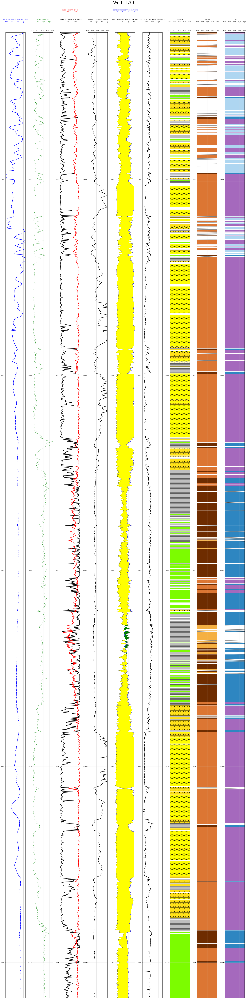

In [126]:
log('Well : L30',ML_new_data, max(ML_new_data['DEPT (M)']), 3250)

In [130]:
# Calculating CO2 properties in reservoir
# EOS of CO2 in CoolProp is based on Span and Wagner (1996)
#
#import matplotlib.pyplot as plt

#!pip install -q coolprop
from CoolProp.CoolProp import PropsSI

#plt.style.use("classic")

# CO2 Properties

In [ ]:
# Pressure gradient and temperature gradient
# Temperature  25–30 C per Km
# critical pressure and temperature of CO2 **(7.4 MPa (1068 psi) and 31.1 °C (88 °F) @2700 ft == 822.96 m

In [131]:
# Input
#P = 3420 # psi

# density of CO2 at Supercritical state 0.4 to 0.6 g cm -3
T = 40 # Celsius
P = 1000000 # pa
T = T + 273.15 # convert C to K

rho = PropsSI('D', 'T', T, 'P', P, 'CO2') / 1000
print(rho)

0.01766920989281334


In [132]:
# Input
#P = 3420 # psi
T = 30*3.5 # Celsius
P = 33000000 # pa
T = T + 273.15 # convert C to K

rho = PropsSI('D', 'T', T, 'P', P, 'CO2') / 1000
print(rho)

0.6769228516946195


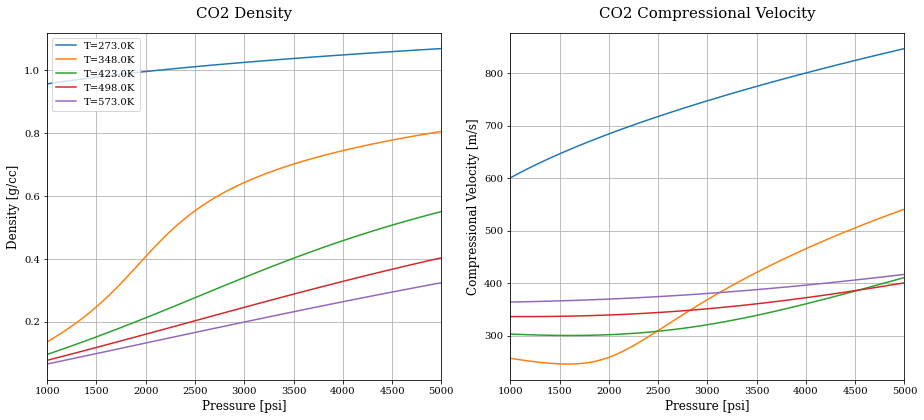

In [7]:
T = np.linspace(273, 573, 5) # Temperatures, K
P_psi = np.linspace(1000, 5000, 100) # Pressures, psi
P = P_psi * 6895 # to Pa

plt.figure(figsize=(13,6))
for i in range(len(T)):
    rho = PropsSI('D', 'T', T[i], 'P', P, 'CO2') / 1000  # D: request density in kg/m3, convert to g/cc
    vp = PropsSI('A', 'T', T[i], 'P', P, 'CO2')  # A: speed of sound in m/s
    K = (rho * vp**2) / 1E+6
  
    plt.subplot(1,2,1)
    plt.plot(P_psi, rho, label="T={}K".format(T[i]))
    plt.grid()
    plt.xlim(min(P_psi), max(P_psi))
    plt.xlabel("Pressure [psi]",size=12); plt.ylabel("Density [g/cc]",size=12)
    plt.title("CO2 Density",size=15,pad=15)
    plt.legend(loc="upper left")

    plt.subplot(1,2,2)
    plt.plot(P_psi, vp, label="T={}K".format(T[i]))
    plt.grid()
    plt.xlim(min(P_psi), max(P_psi))
    plt.xlabel("Pressure [psi]",size=12); plt.ylabel("Compressional Velocity [m/s]",size=12)
    plt.title("CO2 Compressional Velocity",size=15,pad=15)
    # plt.legend()

plt.tight_layout(1.3)
plt.show()

In [ ]:
import plotly.express as px

# 3D visual and hover source
Hover_fig = go.Figure()
Hover_fig = px.scatter_3d(Full_Data.loc[(Full_Data.Type=='PDC')], x='Max_RPM', y='Max WOB (klb)', z='Max Flow Rate (gpm)', color='Average_ROP',
                   opacity=0.7, size='Footage (ft)',
                   title='3D interactive visual for performance assessment',
                    hover_name="Manufacturer", 
                    hover_data=['Well','Formation', 'Type', 'Size', 'Blades', 'Cutter size (mm)'])

#Hover_fig.update_layout(template="plotly_dark")

Hover_fig.show()

#'Re_Run', 'Inner Cutting Structure', 'Outer Cutting Structure',
#                                'Structure', , 'Footage (ft)',
#                                'Dull Grading Characteristics', 'Location', 'Bearings/Seals', 'Gauge',
#                                'Other', 'Reason Pulled